# 1. Imports

In [ ]:
!pip uninstall -y numpy
!pip install numpy==1.24.4 --no-cache-dir --force-reinstall
!pip install --force-reinstall --no-cache-dir pandas seaborn matplotlib catboost
!pip install catboost
!pip uninstall pdpbox -y
!pip install git+https://github.com/SauceCat/PDPbox.git
!pip install lime shap

Found existing installation: numpy 2.0.2
Uninstalling numpy-2.0.2:
  Successfully uninstalled numpy-2.0.2
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.3/17.3 MB 186.1 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
pymc 5.21.2 requires numpy>=1.25.0, but you have numpy 1.24.4 which is incompatible.
tensorflow 2.18.0 requires numpy<2.1.0,>=1.26.0, but you have numpy 1.24.4 which is incompatible.
treescope 0.1.9 requires numpy>=1.25.2, but you have numpy 1.24.4 which is incompatible.
jax 0.5.2 requires numpy>=1.25, but you have numpy 1.24.4 which is incompatible.
blosc2 3.3.0 requires numpy>=1.26, but you have numpy 1.24.4 which is incompatible.
thinc 8.3.6 requires numpy<3.0.0,>=2.0.0, but you have numpy 1.24.4 which is incompatible.
jaxlib 0.5.1 requires numpy>=1.25, but you have numpy 1.24.4 which is incompatible.


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.9/89.9 kB 4.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.0/62.0 kB 137.1 MB/s eta 0:00:00


In [ ]:
!pip uninstall -y numpy pandas seaborn matplotlib catboost pdpbox lime shap xgboost lightgbm
!pip install numpy pandas seaborn matplotlib catboost xgboost lightgbm lime shap --upgrade
!pip install git+https://github.com/SauceCat/PDPbox.git

Found existing installation: numpy 2.0.2
Uninstalling numpy-2.0.2:
  Successfully uninstalled numpy-2.0.2
Found existing installation: pandas 2.2.2
Uninstalling pandas-2.2.2:
  Successfully uninstalled pandas-2.2.2
Found existing installation: seaborn 0.13.2
Uninstalling seaborn-0.13.2:
  Successfully uninstalled seaborn-0.13.2
Found existing installation: matplotlib 3.10.0
Uninstalling matplotlib-3.10.0:
  Successfully uninstalled matplotlib-3.10.0
Found existing installation: shap 0.47.1
Uninstalling shap-0.47.1:
  Successfully uninstalled shap-0.47.1
Found existing installation: xgboost 2.1.4
Uninstalling xgboost-2.1.4:
  Successfully uninstalled xgboost-2.1.4
Found existing installation: lightgbm 4.5.0
Uninstalling lightgbm-4.5.0:
  Successfully uninstalled lightgbm-4.5.0
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.0/62.0 kB 1.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.9/89.9 kB 3.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275

In [ ]:
!pip install boruta

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.9/57.9 kB 2.4 MB/s eta 0:00:00


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import re
import warnings
warnings.filterwarnings('ignore')
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_selection import RFE
from sklearn.metrics import (
    accuracy_score, precision_score, recall_score, f1_score,
    roc_auc_score, classification_report, confusion_matrix
)
from sklearn.inspection import PartialDependenceDisplay, permutation_importance
from catboost import CatBoostClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from boruta import BorutaPy
from imblearn.combine import SMOTEENN
import shap
import lime
import lime.lime_tabular
from lime.lime_tabular import LimeTabularExplainer
from pdpbox import pdp, info_plots
from matplotlib import ticker as mtick

Exception ignored on calling ctypes callback function: <function ThreadpoolController._find_libraries_with_dl_iterate_phdr.<locals>.match_library_callback at 0x7e4d131b1da0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.11/dist-packages/threadpoolctl.py", line 1005, in match_library_callback
    self._make_controller_from_path(filepath)
  File "/usr/local/lib/python3.11/dist-packages/threadpoolctl.py", line 1187, in _make_controller_from_path
    lib_controller = controller_class(
                     ^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.11/dist-packages/threadpoolctl.py", line 114, in __init__
    self.dynlib = ctypes.CDLL(filepath, mode=_RTLD_NOLOAD)
                  ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/lib/python3.11/ctypes/__init__.py", line 376, in __init__
    self._handle = _dlopen(self._name, mode)
                   ^^^^^^^^^^^^^^^^^^^^^^^^^
OSError: dlopen() error
Exception ignored on calling ctypes callback function: <functio

# 2. Data Loading and Preprocessing

In [ ]:
df = pd.read_csv('/content/WA_Fn-UseC_-Telco-Customer-Churn.csv')

In [ ]:
df.head()

,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,...,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
0,7590-VHVEG,Female,0,Yes,No,1,No,No phone service,DSL,No,...,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85,No
1,5575-GNVDE,Male,0,No,No,34,Yes,No,DSL,Yes,...,Yes,No,No,No,One year,No,Mailed check,56.95,1889.5,No
2,3668-QPYBK,Male,0,No,No,2,Yes,No,DSL,Yes,...,No,No,No,No,Month-to-month,Yes,Mailed check,53.85,108.15,Yes
3,7795-CFOCW,Male,0,No,No,45,No,No phone service,DSL,Yes,...,Yes,Yes,No,No,One year,No,Bank transfer (automatic),42.30,1840.75,No
4,9237-HQITU,Female,0,No,No,2,Yes,No,Fiber optic,No,...,No,No,No,No,Month-to-month,Yes,Electronic check,70.70,151.65,Yes


In [ ]:
df.dtypes

,0
customerID,object
gender,object
SeniorCitizen,int64
Partner,object
Dependents,object
tenure,int64
PhoneService,object
MultipleLines,object
InternetService,object
OnlineSecurity,object


In [ ]:
df.columns.values

array(['customerID', 'gender', 'SeniorCitizen', 'Partner', 'Dependents',
       'tenure', 'PhoneService', 'MultipleLines', 'InternetService',
       'OnlineSecurity', 'OnlineBackup', 'DeviceProtection',
       'TechSupport', 'StreamingTV', 'StreamingMovies', 'Contract',
       'PaperlessBilling', 'PaymentMethod', 'MonthlyCharges',
       'TotalCharges', 'Churn'], dtype=object)

In [ ]:
df.duplicated().sum()

np.int64(0)

In [ ]:
# Converting TotalCharges to numeric and handling missing values
df['TotalCharges'] = pd.to_numeric(df['TotalCharges'], errors='coerce')
print(df.isnull().sum())
df['TotalCharges'].fillna(df['TotalCharges'].median(), inplace=True)
print(df.shape)

customerID           0
gender               0
SeniorCitizen        0
Partner              0
Dependents           0
tenure               0
PhoneService         0
MultipleLines        0
InternetService      0
OnlineSecurity       0
OnlineBackup         0
DeviceProtection     0
TechSupport          0
StreamingTV          0
StreamingMovies      0
Contract             0
PaperlessBilling     0
PaymentMethod        0
MonthlyCharges       0
TotalCharges        11
Churn                0
dtype: int64
(7043, 21)


In [ ]:
# customer ID drop
df.drop(columns=['customerID'], inplace=True)

In [ ]:
# Encoding SeniorCitizen as Yes/No
df['SeniorCitizen'] = df['SeniorCitizen'].map({1: 'Yes', 0: 'No'})

In [ ]:
# create tenure groups by binning
tenure_labels = [f"{i} - {i+11}" for i in range(1, 72, 12)]
df['tenure_group'] = pd.cut(df['tenure'], range(1, 80, 12), right=False, labels=tenure_labels)
df['tenure_group'].fillna(df['tenure_group'].mode()[0], inplace=True)

# 3. EDA

## Univariate Analysis

### Distribution of Churn Categories

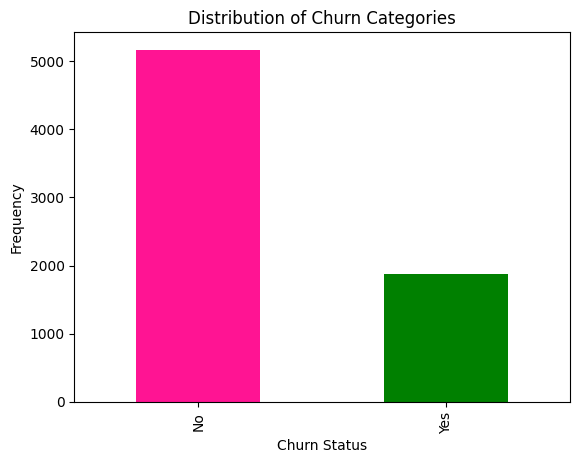

In [ ]:
df['Churn'].value_counts().plot(kind='bar', color=['deeppink', 'green'])
plt.title('Distribution of Churn Categories')
plt.ylabel('Frequency')
plt.xlabel('Churn Status')
plt.show()

The majority of customers did not churn, while a smaller portion did churn. This indicates an imbalanced dataset, with significantly more non-churners than churners.

## Multivariate Analysis: Categorical Features

### Churn Rate Across Categorical Features

<Figure size 1000x500 with 0 Axes>

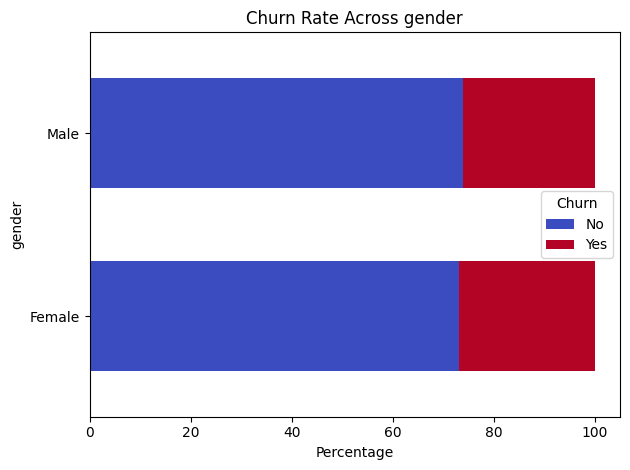

<Figure size 1000x500 with 0 Axes>

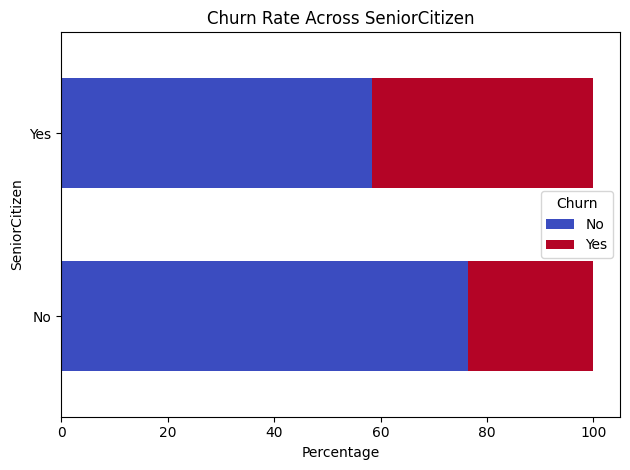

<Figure size 1000x500 with 0 Axes>

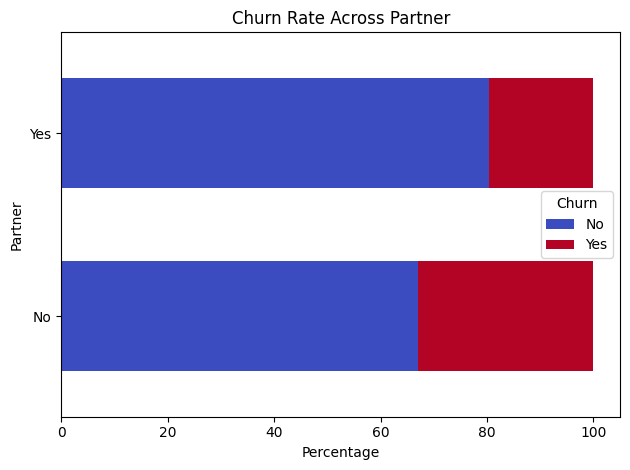

<Figure size 1000x500 with 0 Axes>

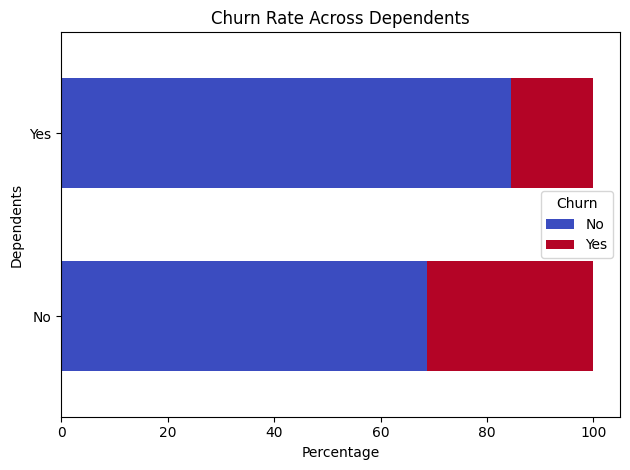

<Figure size 1000x500 with 0 Axes>

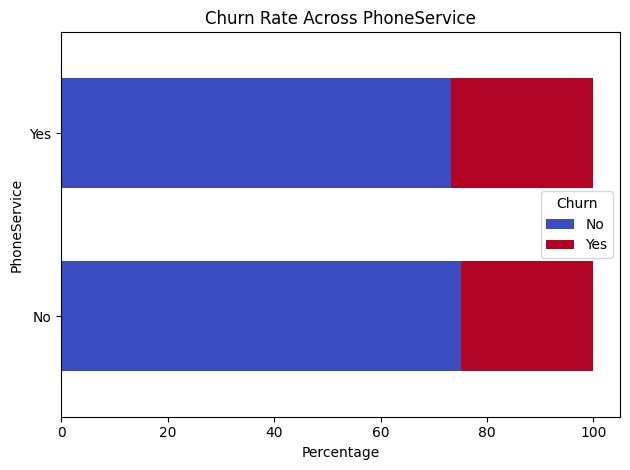

<Figure size 1000x500 with 0 Axes>

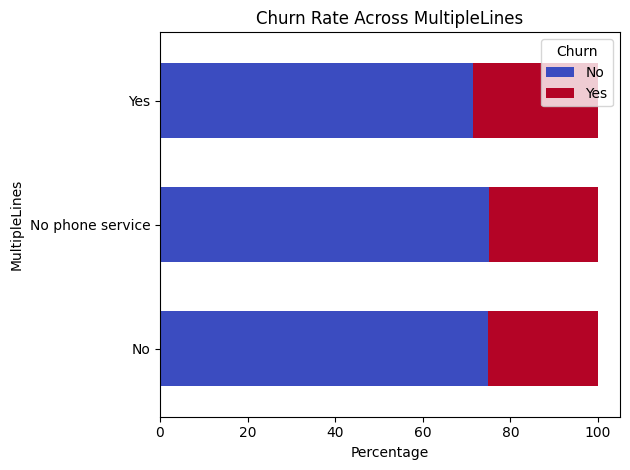

<Figure size 1000x500 with 0 Axes>

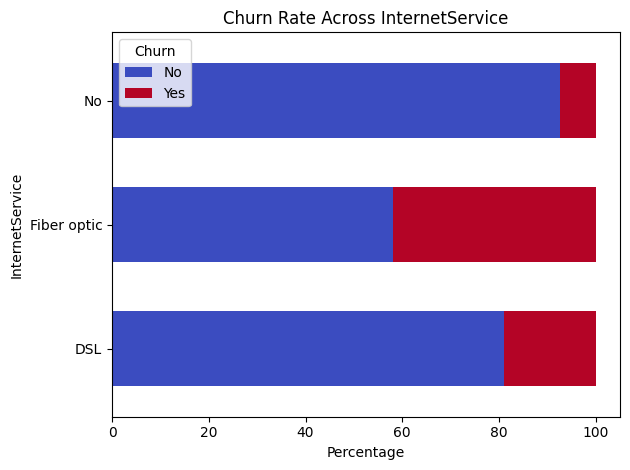

<Figure size 1000x500 with 0 Axes>

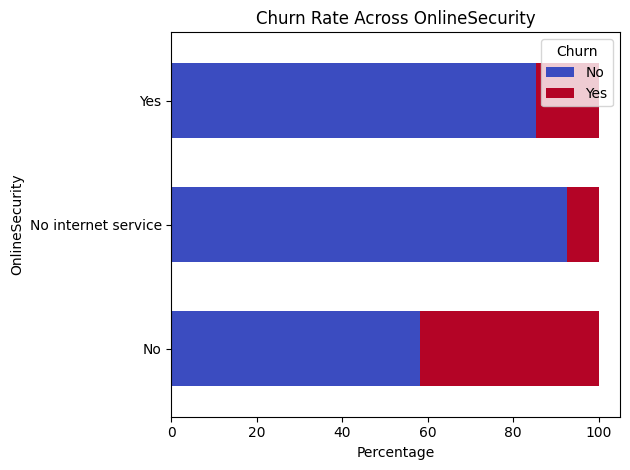

<Figure size 1000x500 with 0 Axes>

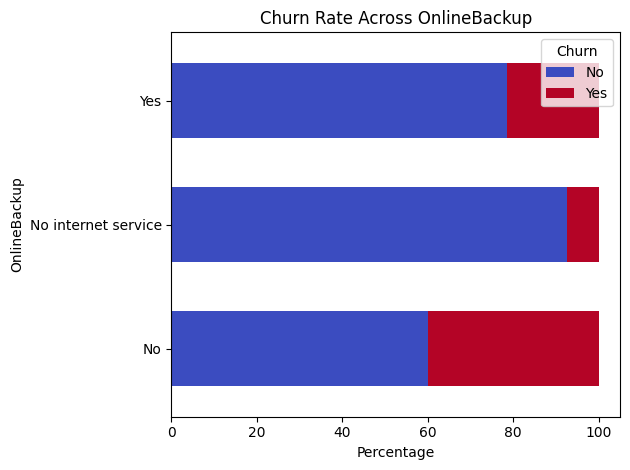

<Figure size 1000x500 with 0 Axes>

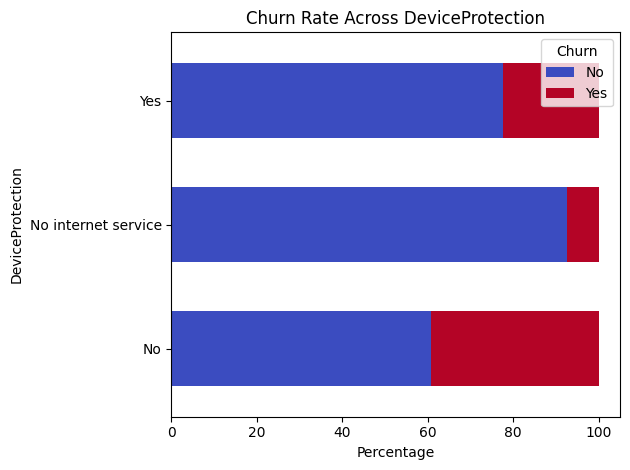

<Figure size 1000x500 with 0 Axes>

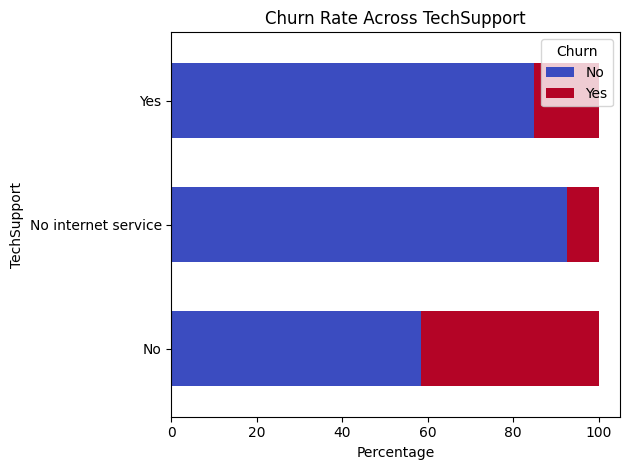

<Figure size 1000x500 with 0 Axes>

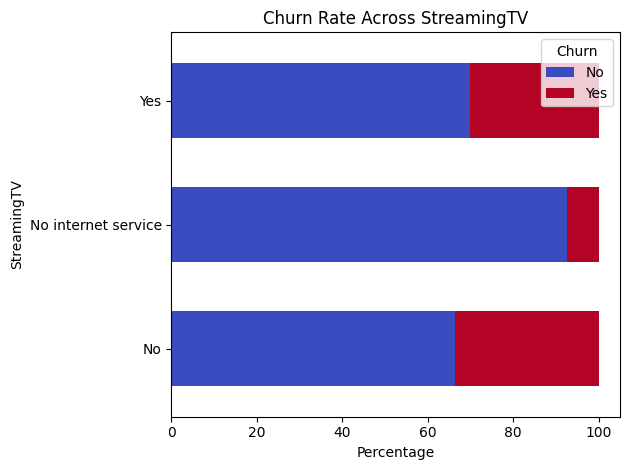

<Figure size 1000x500 with 0 Axes>

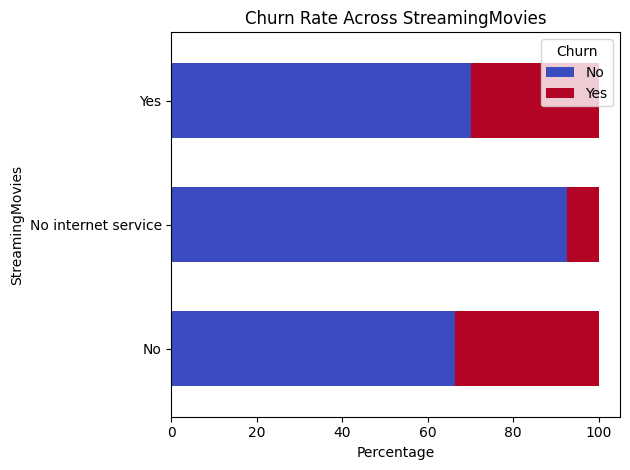

<Figure size 1000x500 with 0 Axes>

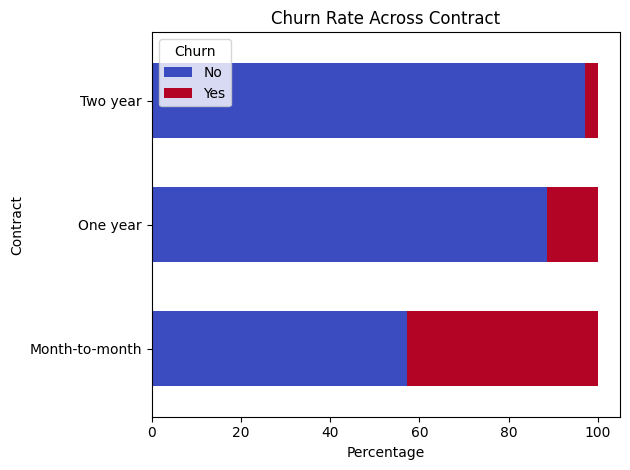

<Figure size 1000x500 with 0 Axes>

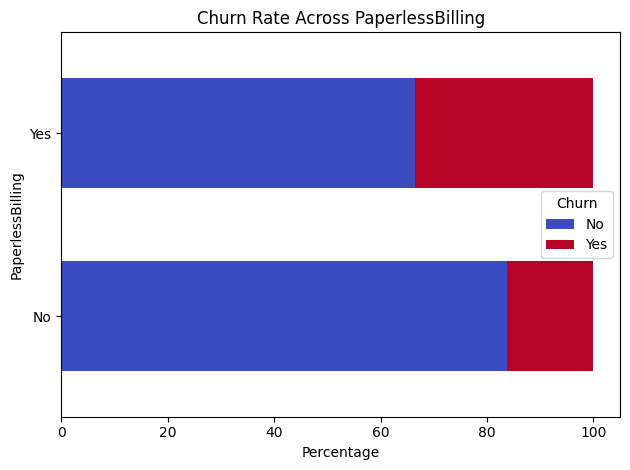

<Figure size 1000x500 with 0 Axes>

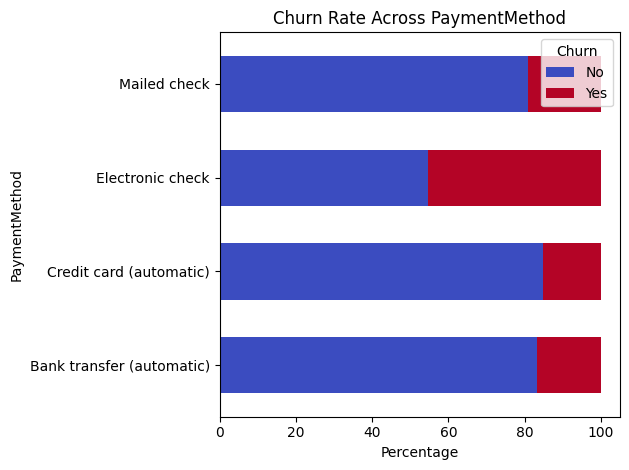

<Figure size 1000x500 with 0 Axes>

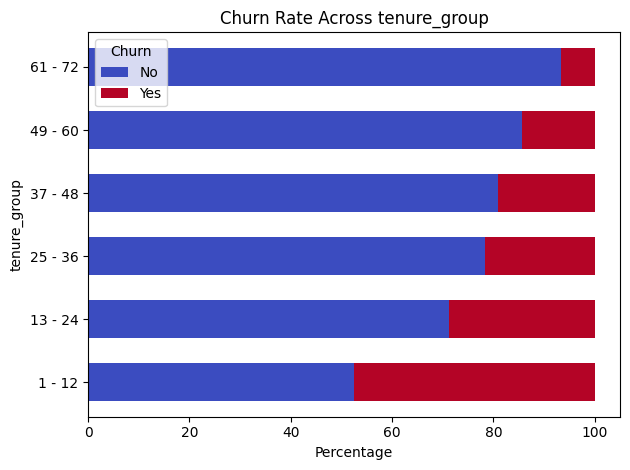

In [ ]:
features = df.drop(columns=['Churn', 'TotalCharges', 'MonthlyCharges', 'tenure']).columns
for feature in features:
    ct = pd.crosstab(df[feature], df['Churn'], normalize='index') * 100
    ct = ct.reset_index()
    plt.figure(figsize=(10, 5))
    ct.set_index(feature).plot(kind='barh', stacked=True, colormap='coolwarm', width=0.6)
    plt.title(f'Churn Rate Across {feature}')
    plt.xlabel('Percentage')
    plt.ylabel(feature)
    plt.tight_layout()
    plt.show()

The purpose is identifying which categories have higher churn tendencies, providing insights into potential risk factors for customer loss.

## Multivariate Analysis: Numerical Features

### Monthly Charges Distribution for customers who churned vs. did not churn

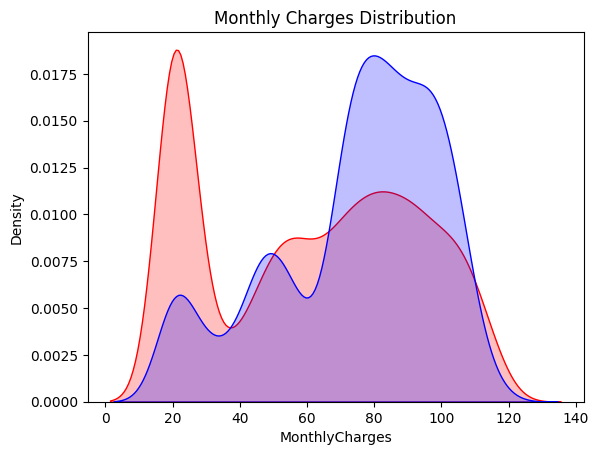

In [ ]:
sns.kdeplot(df[df["Churn"]=='No']['MonthlyCharges'], shade=True, label="No Churn", color='red')
sns.kdeplot(df[df['Churn']=='Yes']['MonthlyCharges'], shade=True, label="Churn", color='blue')
plt.title('Monthly Charges Distribution')
plt.show()

Customers who churned (blue) tend to have higher monthly charges, while non-churners (red) are more concentrated around lower monthly charges. This indicates that higher monthly costs may be associated with a greater likelihood of churn.

### Total Charges Distribution for customers who churned vs. did not churn

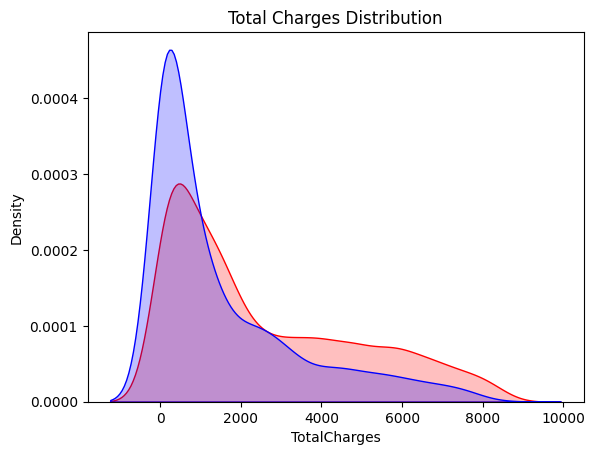

In [ ]:
sns.kdeplot(df[df['Churn']=='No']['TotalCharges'], shade=True, label="No Churn", color='red')
sns.kdeplot(df[df['Churn']=='Yes']['TotalCharges'], shade=True, label='Churn', color='blue')
plt.title('Total Charges Distribution')
plt.show()

Churned customers (blue) are mostly concentrated at lower total charges, suggesting they tend to leave early. Non-churners (red) show a more spread-out distribution with a longer tail, indicating they stay longer and accumulate higher charges over time.

### Total Charges vs. Monthly Charges

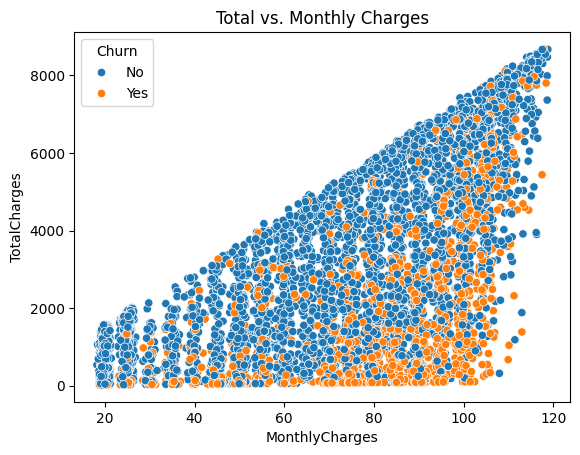

In [ ]:
sns.scatterplot(data=df, x='MonthlyCharges', y='TotalCharges', hue='Churn')
plt.title("Total vs. Monthly Charges")
plt.show()

Customers who churned are mostly concentrated in the lower TotalCharges range, indicating they tend to leave early in their subscription. Non-churners are more spread out and dominate at higher TotalCharges, suggesting they stay longer.

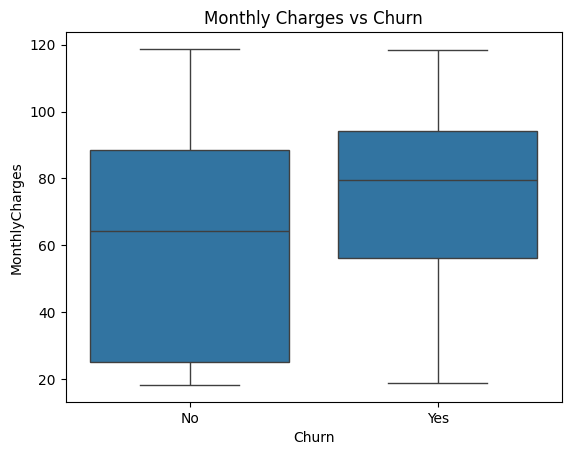

In [ ]:
sns.boxplot(data=df, x="Churn", y='MonthlyCharges')
plt.title('Monthly Charges vs Churn')
plt.show()

## Column Summary

In [ ]:
categorical_cols = df.select_dtypes(include='object').columns.tolist()
numerical_cols = df.select_dtypes(include=['int64', 'float64']).columns.tolist()
for col in numerical_cols:
    if df[col].nunique() < 10:
        categorical_cols.append(col)
        numerical_cols.remove(col)

print("Categorical columns:", categorical_cols)
print("Numerical columns:", numerical_cols)

Categorical columns: ['gender', 'SeniorCitizen', 'Partner', 'Dependents', 'PhoneService', 'MultipleLines', 'InternetService', 'OnlineSecurity', 'OnlineBackup', 'DeviceProtection', 'TechSupport', 'StreamingTV', 'StreamingMovies', 'Contract', 'PaperlessBilling', 'PaymentMethod', 'Churn']
Numerical columns: ['tenure', 'MonthlyCharges', 'TotalCharges']


# 4. Feature Engineering

### Monthly Cost Per Tenure between churned and non-churned customers

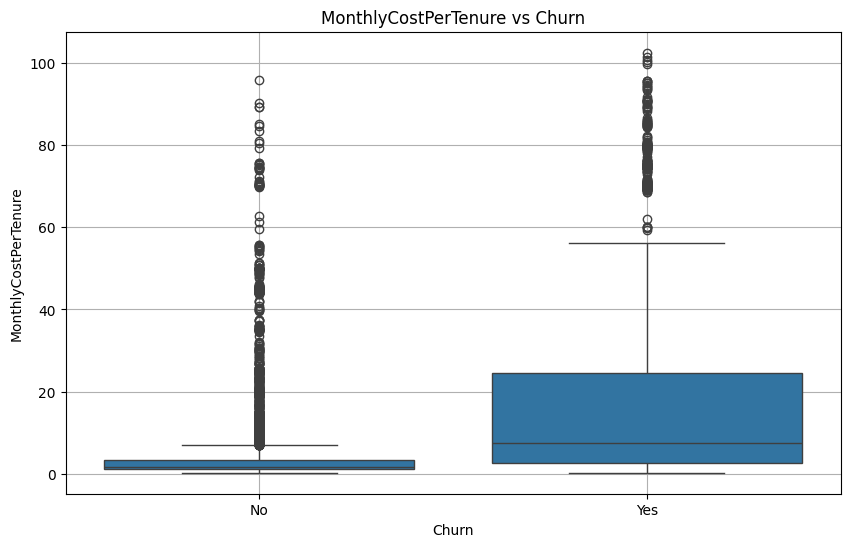

In [ ]:
bins = [0, 12, 24, 48, 60, np.inf]
labels = ['0-12m', '12-24m', '24-48m', '48-60m', '60m+']
df['tenure_group'] = pd.cut(df['tenure'], bins=bins, labels=labels)

df['MonthlyCostPerTenure'] = df['MonthlyCharges'] / df['tenure']
df['MonthlyCostPerTenure'].replace([np.inf, -np.inf], np.nan, inplace=True)
df['MonthlyCostPerTenure'].fillna(df['MonthlyCostPerTenure'].median(), inplace=True)

plt.figure(figsize=(10, 6))
sns.boxplot(x='Churn', y='MonthlyCostPerTenure', data=df)
plt.title('MonthlyCostPerTenure vs Churn')
plt.grid(True)
plt.show()

 Most non-churned customers have low monthly cost per tenure, while churned customers show a wider spread and higher median, indicating that paying more relative to tenure is associated with a higher likelihood of churn.

 (Tenure: length of time a customer has been with the company)

### Churn Rate by MonthlyCostPerTenure group

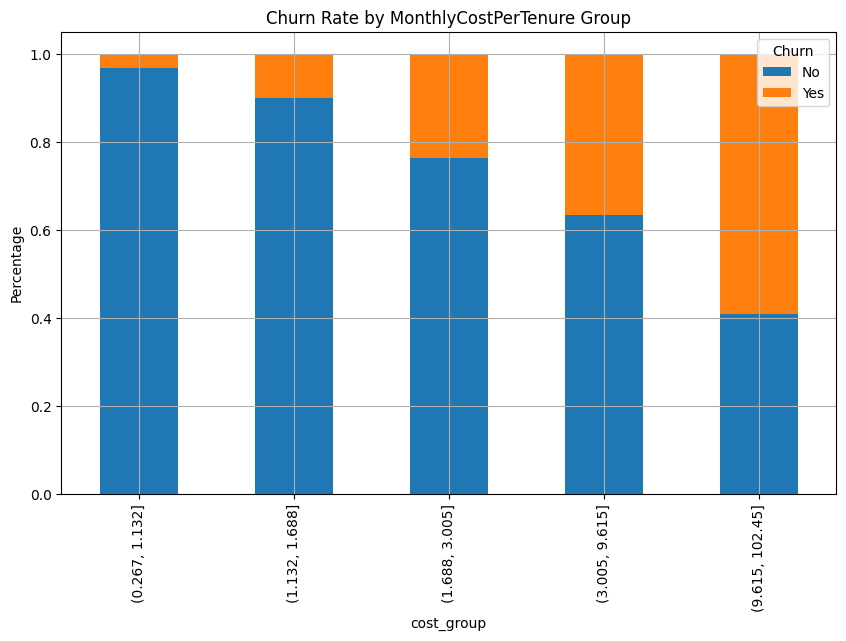

In [ ]:
df['cost_group'] = pd.qcut(df['MonthlyCostPerTenure'], q=5)
churn_rate = df.groupby('cost_group')['Churn'].value_counts(normalize=True).unstack()

churn_rate.plot(kind='bar', stacked=True, figsize=(10,6))
plt.title('Churn Rate by MonthlyCostPerTenure Group')
plt.ylabel('Percentage')
plt.grid(True)
plt.show()

As the cost per tenure increases, the proportion of churned customers also increases. In the highest cost group (9.615 to 102.45), churn is more common than retention. This indicates that customers who pay a lot in a short time are more likely to leave the service.

### Distribution of Service Count

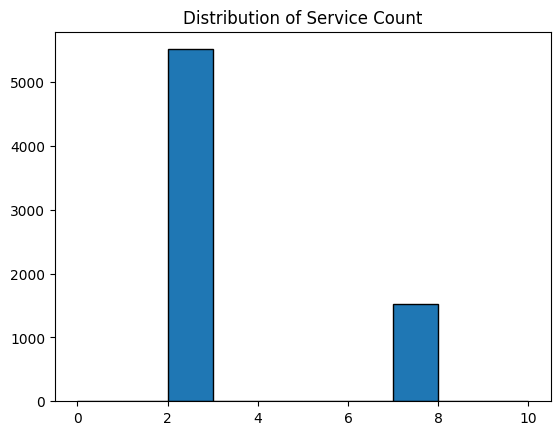

In [ ]:
services = ["PhoneService", "MultipleLines", "InternetService",
            "OnlineSecurity", "OnlineBackup", "DeviceProtection",
            "TechSupport", "StreamingTV", "StreamingMovies"]
service_dummies = pd.get_dummies(df[services], prefix_sep='_', drop_first=False)
df = pd.concat([df, service_dummies], axis=1)

services_to_count = [
    "PhoneService_Yes", "MultipleLines_No phone service", "InternetService_Fiber optic",
    "InternetService_DSL", "OnlineSecurity_No internet service", "OnlineBackup_No internet service",
    "DeviceProtection_No internet service", "TechSupport_No internet service", "StreamingTV_No internet service",
    "StreamingMovies_No internet service"
]
df["ServiceCount"] = df[services_to_count].sum(axis=1)

plt.hist(df["ServiceCount"], bins=range(11), edgecolor='black')
plt.title('Distribution of Service Count')
plt.show()

Represents how many services each customer has. Most customers have only 2 services, while a smaller group has up to 8. This indicates that the majority of customers use a limited number of services, with only a subset adopting a broader range of offerings.

### Churn Rate by Service Count

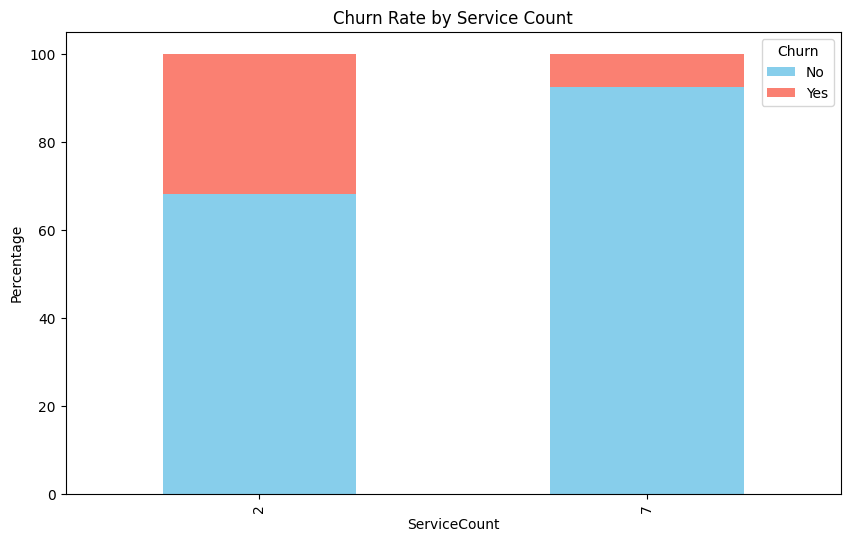

In [ ]:
churn_by_service = df.groupby(['ServiceCount', 'Churn']).size().unstack().fillna(0)
churn_by_service_percent = churn_by_service.div(churn_by_service.sum(axis=1), axis=0) * 100
churn_by_service_percent.plot(kind='bar', stacked=True, figsize=(10,6), color=['skyblue', 'salmon'])
plt.title("Churn Rate by Service Count")
plt.ylabel("Percentage")
plt.show()

This Stacked bar chart shows that customers with fewer services (ServiceCount = 2) have a higher churn rate compared to those with more services (ServiceCount = 7). This suggests that customers using more services are more engaged and less likely to churn, while limited service usage may indicate lower satisfaction or weaker commitment.

### Churn By Family Package Status

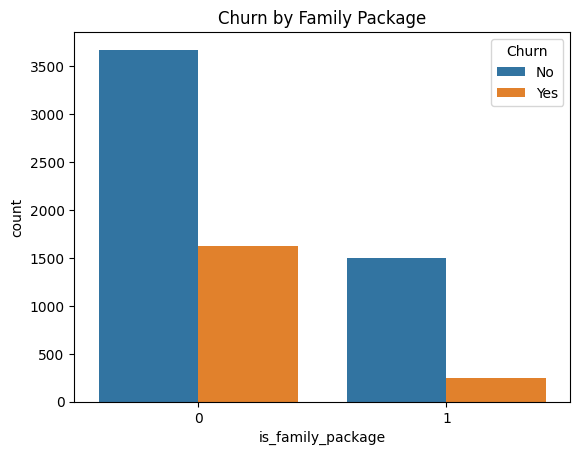

In [ ]:
df['is_family_package'] = ((df['Partner'] == 'Yes') & (df['Dependents'] == 'Yes')).astype(int)
sns.countplot(x='is_family_package', hue='Churn', data=df)
plt.title("Churn by Family Package")
plt.show()

The plot shows that customers without a family package have a noticeably higher churn count compared to those with a family package. This suggests that customers who have both a partner and dependents are more likely to stay, possibly due to greater service reliance or shared usage.

### Churn by Short Contract Paperless

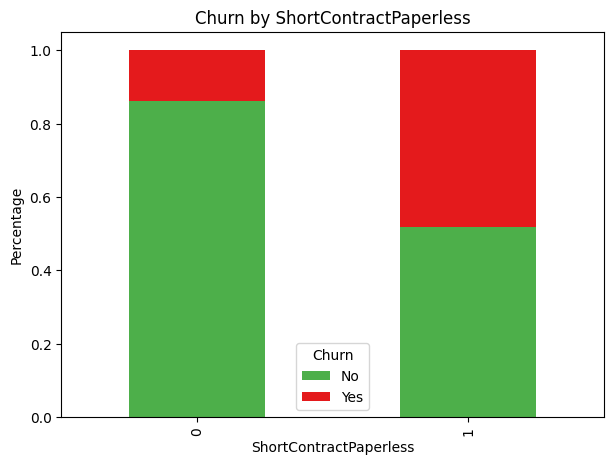

In [ ]:
df["ShortContractPaperless"] = ((df["Contract"] == "Month-to-month") & (df["PaperlessBilling"] == "Yes")).astype(int)
stack_data = df.groupby(["ShortContractPaperless", "Churn"]).size().unstack().fillna(0)
stack_data_percent = stack_data.div(stack_data.sum(axis=1), axis=0)

stack_data_percent.plot(kind="bar", stacked=True, figsize=(7, 5), color=["#4daf4a", "#e41a1c"])
plt.title("Churn by ShortContractPaperless")
plt.ylabel("Percentage")
plt.show()

The chart shows that customers on a month-to-month contract with paperless billing have a much higher churn rate compared to those who don't meet both conditions. This indicates that short-term, low-commitment plans combined with paperless billing are associated with a greater likelihood of customer churn.

### Discount Score vs Churn

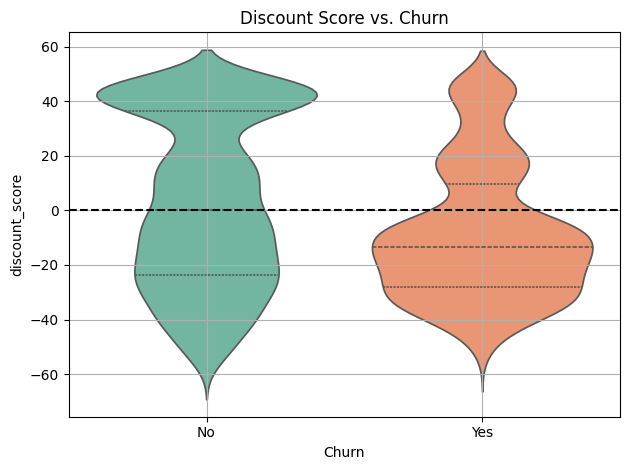

In [ ]:
avg_charges_per_contract = df.groupby('Contract')['MonthlyCharges'].transform('mean')
df['discount_score'] = avg_charges_per_contract - df['MonthlyCharges']

sns.violinplot(x='Churn', y='discount_score', data=df, palette='Set2', inner='quartile')
plt.title('Discount Score vs. Churn')
plt.axhline(0, color='black', linestyle='--')
plt.grid(True)
plt.tight_layout()
plt.show()

The plot shows that non-churned customers generally have higher discount scores (above the dashed zero line), meaning they pay less than the average for their contract type. In contrast, churned customers mostly have lower or negative discount scores, indicating they pay more than average. This suggests that offering better pricing relative to peers may help reduce churn.

### Dropping Features

In [ ]:
df.drop(columns=["PhoneService", "MultipleLines", "InternetService",
            "OnlineSecurity", "OnlineBackup", "DeviceProtection",
            "TechSupport", "StreamingTV", "StreamingMovies","Partner","Dependents"], inplace=True)

This is the dropped features as their information was already captured through feature engineering

# 5. Feature Selection

In [ ]:
df_features = df.drop(columns=['Churn'])
df_target = df['Churn']

In [ ]:
#encoding categorical features
X_encoded = pd.get_dummies(df_features, drop_first=True)

In [ ]:
#encoding target
y = LabelEncoder().fit_transform(df_target)

In [ ]:
# Balancing data using SMOTEENN
sm = SMOTEENN(random_state=0)
X_resampled, y_resampled = sm.fit_resample(X_encoded, y)
X_train, X_test, y_train, y_test = train_test_split(
    X_resampled, y_resampled, test_size=0.2, stratify=y_resampled, random_state=42)

### Boruta Feature Selection

In [ ]:
rf_for_boruta = RandomForestClassifier(n_estimators=100, random_state=42, n_jobs=-1)
boruta_selector = BorutaPy(estimator=rf_for_boruta, n_estimators='auto', verbose=2, random_state=42)
boruta_selector.fit(X_train.values, y_train)
boruta_features = X_train.columns[boruta_selector.support_].tolist()
print("Selected Features by Boruta:", boruta_features)

Iteration: 	1 / 100
Confirmed: 	0
Tentative: 	50
Rejected: 	0
Iteration: 	2 / 100
Confirmed: 	0
Tentative: 	50
Rejected: 	0
Iteration: 	3 / 100
Confirmed: 	0
Tentative: 	50
Rejected: 	0
Iteration: 	4 / 100
Confirmed: 	0
Tentative: 	50
Rejected: 	0
Iteration: 	5 / 100
Confirmed: 	0
Tentative: 	50
Rejected: 	0
Iteration: 	6 / 100
Confirmed: 	0
Tentative: 	50
Rejected: 	0
Iteration: 	7 / 100
Confirmed: 	0
Tentative: 	50
Rejected: 	0
Iteration: 	8 / 100
Confirmed: 	14
Tentative: 	13
Rejected: 	23
Iteration: 	9 / 100
Confirmed: 	14
Tentative: 	13
Rejected: 	23
Iteration: 	10 / 100
Confirmed: 	14
Tentative: 	13
Rejected: 	23
Iteration: 	11 / 100
Confirmed: 	14
Tentative: 	13
Rejected: 	23
Iteration: 	12 / 100
Confirmed: 	14
Tentative: 	10
Rejected: 	26
Iteration: 	13 / 100
Confirmed: 	14
Tentative: 	10
Rejected: 	26
Iteration: 	14 / 100
Confirmed: 	14
Tentative: 	10
Rejected: 	26
Iteration: 	15 / 100
Confirmed: 	14
Tentative: 	10
Rejected: 	26
Iteration: 	16 / 100
Confirmed: 	14
Tentative: 	

In [ ]:
feature_ranks = pd.DataFrame({
    'Feature': X_train.columns,
    'Rank': boruta_selector.ranking_,
    'Selected': boruta_selector.support_
}).sort_values(by='Rank')

feature_ranks.head(30)

,Feature,Rank,Selected
0,tenure,1,True
1,MonthlyCharges,1,True
2,TotalCharges,1,True
3,MonthlyCostPerTenure,1,True
12,OnlineSecurity_No,1,True
15,OnlineBackup_No,1,True
10,InternetService_Fiber optic,1,True
18,DeviceProtection_No,1,True
21,TechSupport_No,1,True
46,cost_group_(1.132_ 1.688_,1,True


### RFE Feature Selection

In [ ]:
log_model_for_rfe = LogisticRegression(max_iter=1000, solver='liblinear')
rfe = RFE(log_model_for_rfe, n_features_to_select=10)
rfe.fit(X_train, y_train)
rfe_features = X_train.columns[rfe.support_].tolist()
print("Selected Features by RFE:", rfe_features)

Selected Features by RFE: ['PhoneService_Yes', 'MultipleLines_No', 'MultipleLines_Yes', 'DeviceProtection_No', 'DeviceProtection_Yes', 'TechSupport_No', 'StreamingTV_No internet service', 'cost_group_(1.688, 3.005]', 'cost_group_(3.005, 9.615]', 'cost_group_(9.615, 102.45]']


### Logistic Regression Feature Selection

In [ ]:
model_features = {}
lr = LogisticRegression(max_iter=1000, solver='liblinear')
lr.fit(X_train, y_train)
lr_importance = pd.Series(abs(lr.coef_[0]), index=X_train.columns)
model_features['LogisticRegression'] = lr_importance.sort_values(ascending=False).head(10).index.tolist()
print("Top 10 Features for Logistic Regression:")
print(model_features['LogisticRegression'])

Top 10 Features for Logistic Regression:
['TechSupport_No', 'InternetService_Fiber optic', 'DeviceProtection_No', 'OnlineSecurity_No', 'PaymentMethod_Mailed check', 'PaperlessBilling_Yes', 'OnlineBackup_No', 'is_family_package', 'PaymentMethod_Electronic check', 'StreamingMovies_Yes']


### Random Forest Feature Selection

In [ ]:
rf = RandomForestClassifier(n_estimators=100, random_state=42)
rf.fit(X_train, y_train)
rf_importance = pd.Series(rf.feature_importances_, index=X_train.columns)
model_features['RandomForest'] = rf_importance.sort_values(ascending=False).head(10).index.tolist()
print("Top 10 Features for Random Forest:")
print(model_features['RandomForest'])

Top 10 Features for Random Forest:
['MonthlyCostPerTenure', 'tenure', 'TechSupport_No', 'OnlineSecurity_No', 'TotalCharges', 'cost_group_(9.615, 102.45]', 'PaymentMethod_Electronic check', 'InternetService_Fiber optic', 'discount_score', 'MonthlyCharges']


### Decision Tree Feature Selection

In [ ]:
dt = DecisionTreeClassifier(random_state=42)
dt.fit(X_train, y_train)
dt_importance = pd.Series(dt.feature_importances_, index=X_train.columns)
model_features['DecisionTree'] = dt_importance.sort_values(ascending=False).head(10).index.tolist()
print("Top 10 Features for Decision Tree:")
print(model_features['DecisionTree'])

Top 10 Features for Decision Tree:
['MonthlyCostPerTenure', 'TotalCharges', 'cost_group_(1.688, 3.005]', 'OnlineSecurity_No', 'TechSupport_No', 'discount_score', 'InternetService_Fiber optic', 'MonthlyCharges', 'PaymentMethod_Electronic check', 'PaperlessBilling_Yes']


### Cat Boost Feature Selection

In [ ]:
cb = CatBoostClassifier(verbose=False, random_state=42)
cb.fit(X_train, y_train)
cb_importance = pd.Series(cb.feature_importances_, index=X_train.columns)
model_features['CatBoost'] = cb_importance.sort_values(ascending=False).head(10).index.tolist()
print("Top 10 Features for CatBoost:")
print(model_features['CatBoost'])

Top 10 Features for CatBoost:
['MonthlyCostPerTenure', 'TotalCharges', 'MonthlyCharges', 'discount_score', 'tenure', 'TechSupport_No', 'TechSupport_Yes', 'OnlineSecurity_No', 'PaperlessBilling_Yes', 'cost_group_(1.688, 3.005]']


### XG Boost Feature Selection

In [ ]:
X_train.columns = [re.sub(r"[\[\]\<]", "_", col) for col in X_train.columns]
X_test.columns = [re.sub(r"[\[\]\<]", "_", col) for col in X_test.columns]
xgb = XGBClassifier(use_label_encoder=False, eval_metric='logloss', random_state=42)
xgb.fit(X_train, y_train)
xgb_importance = pd.Series(xgb.feature_importances_, index=X_train.columns)
model_features['XGBoost'] = xgb_importance.sort_values(ascending=False).head(10).index.tolist()
print("Top 10 Features for XGBoost:")
print(model_features['XGBoost'])

Top 10 Features for XGBoost:
['cost_group_(1.688, 3.005_', 'MonthlyCostPerTenure', 'InternetService_Fiber optic', 'OnlineSecurity_No', 'cost_group_(1.132, 1.688_', 'TechSupport_No', 'cost_group_(9.615, 102.45_', 'TechSupport_Yes', 'DeviceProtection_Yes', 'OnlineSecurity_Yes']


### LightGBM Feature Selection

In [ ]:
X_train.columns = [re.sub(r"[\[\]\<,]", "_", col) for col in X_train.columns]
X_test.columns = [re.sub(r"[\[\]\<,]", "_", col) for col in X_test.columns]
lgb = LGBMClassifier(random_state=42)
lgb.fit(X_train, y_train)
lgb_importance = pd.Series(lgb.feature_importances_, index=X_train.columns)
model_features['LightGBM'] = lgb_importance.sort_values(ascending=False).head(10).index.tolist()
print("Top 10 Features for LightGBM:")
print(model_features['LightGBM'])

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 2536, number of negative: 2176
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002080 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1186
[LightGBM] [Info] Number of data points in the train set: 4712, number of used features: 50
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.538200 -> initscore=0.153100
[LightGBM] [Info] Start training from score 0.153100
Top 10 Features for LightGBM:
['TotalCharges', 'MonthlyCostPerTenure', 'MonthlyCharges', 'discount_score', 'tenure', 'PaymentMethod_Electronic check', 'PaperlessBilling_Yes', 'TechSupport_No', 'OnlineSecurity_No', 'gender_Male']


### KNN Feature Selection

In [ ]:
knn_corr = X_train.corrwith(pd.Series(y_train)).abs()
model_features['KNN'] = knn_corr.sort_values(ascending=False).head(10).index.tolist()
print("Top 10 Features for KNN:")
print(model_features['KNN'])

Top 10 Features for KNN:
['PaymentMethod_Credit card (automatic)', 'MonthlyCostPerTenure', 'cost_group_(1.688_ 3.005_', 'cost_group_(9.615_ 102.45_', 'OnlineSecurity_Yes', 'PaperlessBilling_Yes', 'TechSupport_No', 'Contract_Two year', 'MonthlyCharges', 'InternetService_Fiber optic']


### NN Feature Selection

In [ ]:
nn = MLPClassifier(hidden_layer_sizes=(128, 64), activation='relu', max_iter=500, random_state=42)
nn.fit(X_train, y_train)
nn_result = permutation_importance(nn, X_train, y_train, n_repeats=5, random_state=42, n_jobs=1)
nn_importance = pd.Series(nn_result.importances_mean, index=X_train.columns)
model_features['NeuralNetwork'] = nn_importance.sort_values(ascending=False).head(10).index.tolist()
print("Top 10 Features for Neural Network:")
print(model_features['NeuralNetwork'])

Top 10 Features for Neural Network:
['TotalCharges', 'discount_score', 'MonthlyCharges', 'MonthlyCostPerTenure', 'tenure', 'PaymentMethod_Electronic check', 'PaymentMethod_Mailed check', 'is_family_package', 'OnlineSecurity_No', 'cost_group_(1.688_ 3.005_']


### Final Selected Features

In [ ]:
all_selected = set(boruta_features)
for feature_list in model_features.values():
    all_selected.update(feature_list)
final_selected_features = sorted(all_selected)

In [ ]:
actual_columns = list(X_train.columns)
final_features = []

def normalize(name):
    return re.sub(r"[\[\]\(\),]", "_", name).replace(" ", "_").strip("_").lower()

normalized_columns = {normalize(col): col for col in actual_columns}
normalized_features = [normalize(feat) for feat in final_selected_features]

for nf in normalized_features:
    if nf in normalized_columns:
        final_features.append(normalized_columns[nf])
final_features = sorted(set(final_features))
print(final_features)

['Contract_Two year', 'DeviceProtection_No', 'DeviceProtection_Yes', 'InternetService_Fiber optic', 'MonthlyCharges', 'MonthlyCostPerTenure', 'OnlineBackup_No', 'OnlineSecurity_No', 'OnlineSecurity_Yes', 'PaperlessBilling_Yes', 'PaymentMethod_Credit card (automatic)', 'PaymentMethod_Electronic check', 'PaymentMethod_Mailed check', 'StreamingMovies_Yes', 'TechSupport_No', 'TechSupport_Yes', 'TotalCharges', 'cost_group_(1.132_ 1.688_', 'cost_group_(1.688_ 3.005_', 'cost_group_(9.615_ 102.45_', 'discount_score', 'gender_Male', 'is_family_package', 'tenure']


In [ ]:
X_train_final = X_train[final_features]
X_test_final = X_test[final_features]

# 6. Modelling and Evaluation

In [ ]:
def evaluate_model(name, model, X_test, y_test):
    y_pred = model.predict(X_test)
    print(f"\n{name} Evaluation")
    print(f"Accuracy: {accuracy_score(y_test, y_pred):.2f}")
    print(f"Precision: {precision_score(y_test, y_pred):.2f}")
    print(f"Recall: {recall_score(y_test, y_pred):.2f}")
    print(f"F1 Score: {f1_score(y_test, y_pred):.2f}")
    print(f"AUC: {roc_auc_score(y_test, y_pred):.2f}")
    print("Classification Report:\n", classification_report(y_test, y_pred))
    sns.heatmap(confusion_matrix(y_test, y_pred), annot=True, fmt='d', cmap='Blues')
    plt.title(f'Confusion Matrix - {name}')
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.show()

## Logistic Regression Model


Logistic Regression Evaluation
Accuracy: 0.93
Precision: 0.93
Recall: 0.94
F1 Score: 0.93
AUC: 0.93
Classification Report:
               precision    recall  f1-score   support

           0       0.93      0.92      0.92       544
           1       0.93      0.94      0.93       635

    accuracy                           0.93      1179
   macro avg       0.93      0.93      0.93      1179
weighted avg       0.93      0.93      0.93      1179



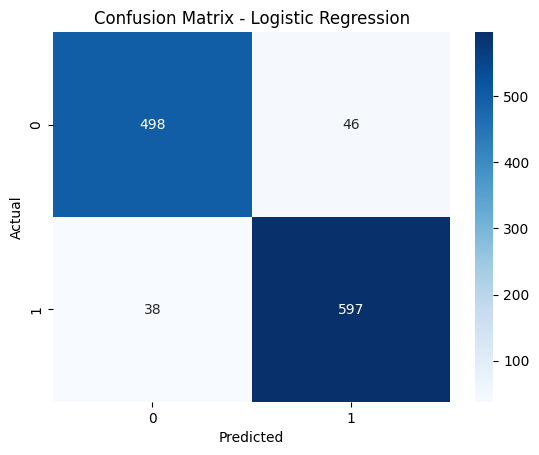

In [ ]:
log_final = LogisticRegression(max_iter=1000, solver='liblinear')
log_final.fit(X_train_final, y_train)
evaluate_model("Logistic Regression", log_final, X_test_final, y_test)

### SHAP for Logistic Regression


SHAP Summary for Logistic Regression


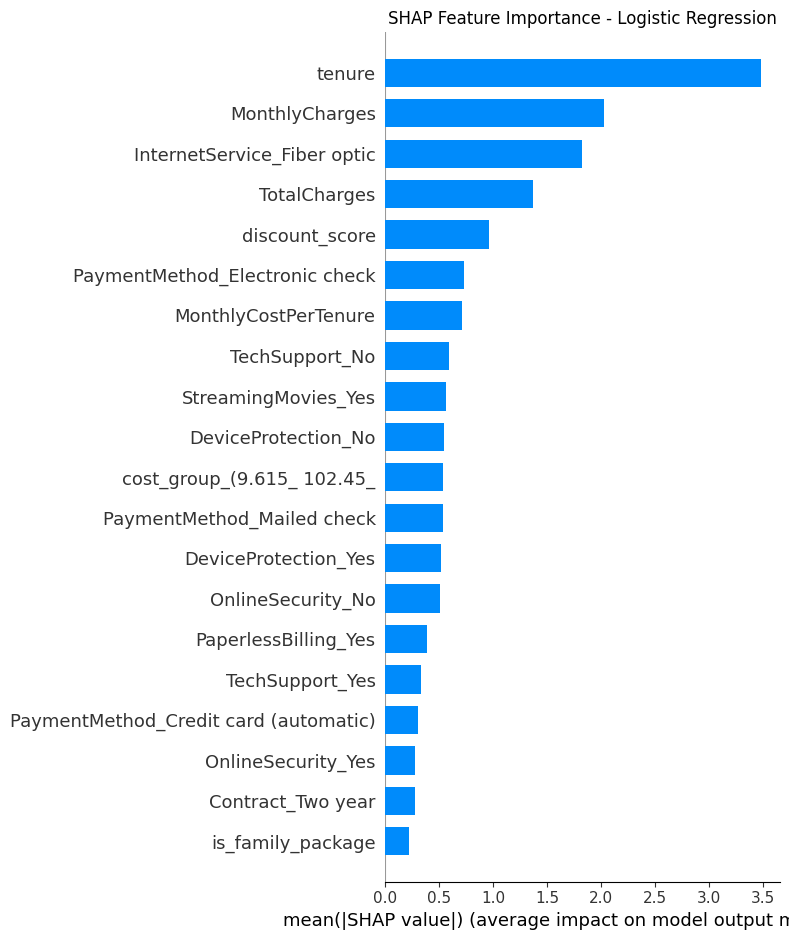

In [ ]:
print("\nSHAP Summary for Logistic Regression")
explainer_log = shap.Explainer(log_final, X_train_final)
shap_values_log = explainer_log(X_test_final)
shap.summary_plot(shap_values_log, X_test_final, plot_type="bar", show=False)
plt.title("SHAP Feature Importance - Logistic Regression")
plt.tight_layout()
plt.show()

The SHAP feature importance plot for the Logistic Regression model reveals that customer tenure is the most influential factor in predicting churn, with longer-tenured customers being less likely to leave.

Other significant contributors include MonthlyCharges, TotalCharges, discount_score, and MonthlyCostPerTenure, indicating that customers paying higher amounts or receiving fewer discounts are more prone to churn.

Additionally, service-related features such as InternetService_Fiber optic and support options like TechSupport_No and OnlineSecurity_No also play notable roles.

In contrast, features like DeviceProtection_No and certain payment methods have comparatively lower influence on the model’s predictions. Overall, the model heavily relies on billing behavior, service type, and tenure to determine churn risk.

### LIME for Logistic Regression

In [ ]:
sample_instance = X_test_final.iloc[0]

explainer = LimeTabularExplainer(
    X_train_final.values,
    feature_names=X_train_final.columns.tolist(),
    class_names=['No Churn', 'Churn'],
    discretize_continuous=True
)

In [ ]:
print("\nLIME Explanation for Logistic Regression")
exp = explainer.explain_instance(sample_instance.values, log_final.predict_proba)
exp.show_in_notebook()


LIME Explanation for Logistic Regression


This LIME explanation for Logistic Regression model illustrates a local interpretation for a single prediction where the model predicted churn with 97% probability. The key drivers behind this prediction include:

* Low tenure (≤ 4 months), contributing most strongly to the churn prediction (0.42 impact),

* Fiber optic internet service, which is often linked to higher churn risk,

* Low total charges and MonthlyCostPerTenure, indicating the customer is new but pays relatively more,

* Absence of Tech Support and Online Security, which are known churn indicators.

On the right side, the feature values show that the customer indeed had low tenure, used electronic check payments (often associated with higher churn), and lacked support services — all reinforcing the churn prediction.


### PDP for Logistic Regression

In [ ]:
selected_feature = 'MonthlyCostPerTenure'
feature_index = X_train_final.columns.tolist().index(selected_feature)


PDP - Logistic Regression


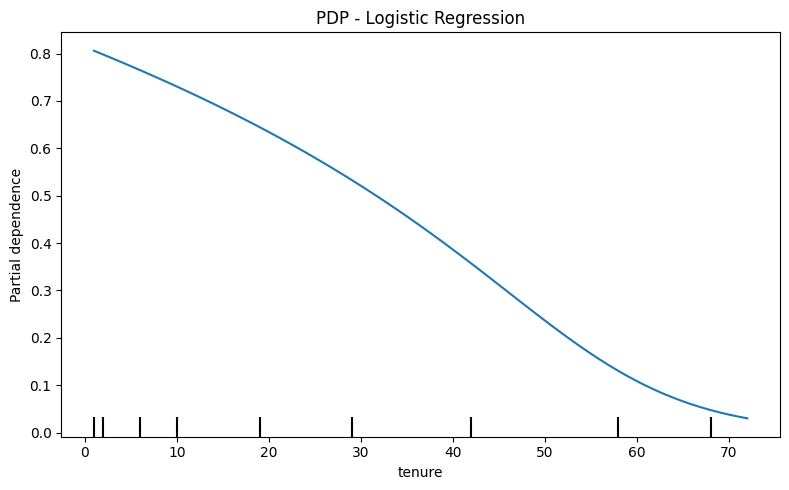

In [ ]:
print("\nPDP - Logistic Regression")
fig, ax = plt.subplots(figsize=(8, 5))
PartialDependenceDisplay.from_estimator(log_final, X_test_final, [feature_index], ax=ax)
ax.set_title("PDP - Logistic Regression")
plt.tight_layout()
plt.show()

The plot shows a strong negative relationship: as tenure increases, the likelihood of churn decreases.

Customers with shorter tenure (new customers) have a much higher probability of churn, while those who have stayed longer are less likely to churn.

### ICE for Logistic Regression


ICE - Logistic Regression


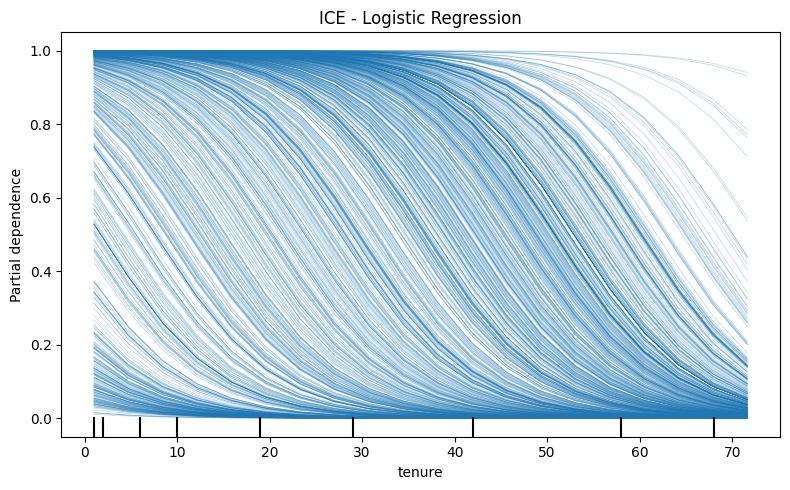

In [ ]:
print("\nICE - Logistic Regression")
fig, ax = plt.subplots(figsize=(8, 5))
PartialDependenceDisplay.from_estimator(log_final, X_test_final, features=[feature_index], kind="individual", grid_resolution=20, ax=ax)
ax.set_title("ICE - Logistic Regression")
plt.tight_layout()
plt.show()

Each line represents one customer’s predicted probability of churn as their tenure value changes.

Most lines slope downward, meaning that as tenure increases, churn probability decreases.

This confirms the trend seen in the PDP: longer-tenure customers are less likely to churn.


## Random Forest Model


Random Forest Evaluation
Accuracy: 0.94
Precision: 0.93
Recall: 0.95
F1 Score: 0.94
AUC: 0.94
Classification Report:
               precision    recall  f1-score   support

           0       0.94      0.92      0.93       544
           1       0.93      0.95      0.94       635

    accuracy                           0.94      1179
   macro avg       0.94      0.94      0.94      1179
weighted avg       0.94      0.94      0.94      1179



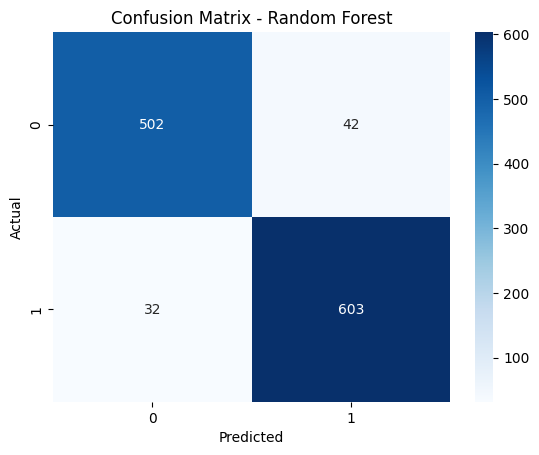

In [ ]:
rf_final = RandomForestClassifier(n_estimators=100, random_state=42)
rf_final.fit(X_train_final, y_train)
evaluate_model("Random Forest", rf_final, X_test_final, y_test)

### SHAP for Random Forest


SHAP Summary for Random Forest


<Figure size 640x480 with 0 Axes>

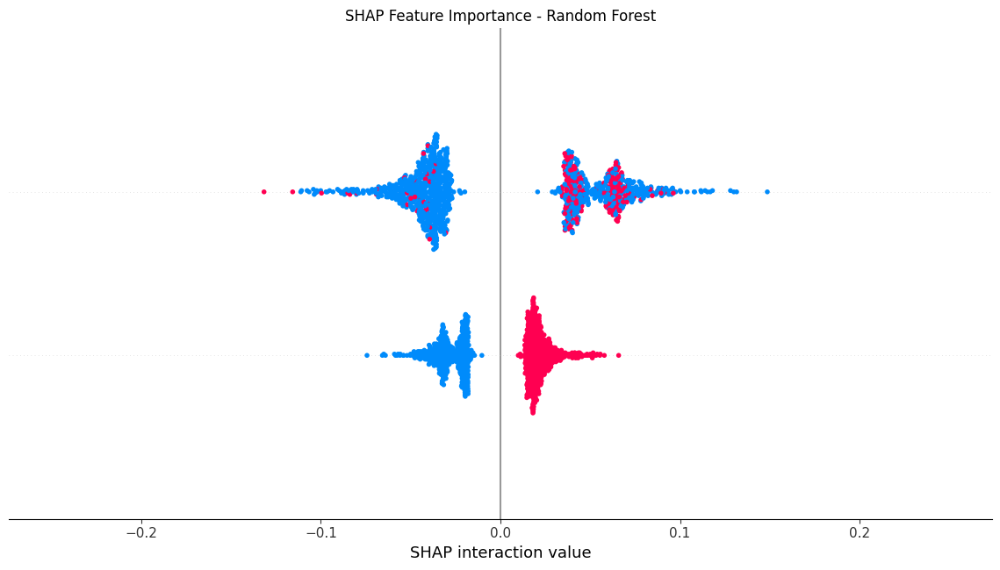

In [ ]:
print("\nSHAP Summary for Random Forest")
explainer_rf = shap.TreeExplainer(rf_final)
shap_values_rf = explainer_rf.shap_values(X_test_final)
shap.summary_plot(shap_values_rf, X_test_final, plot_type="bar", show=False)
plt.title("SHAP Feature Importance - Random Forest")
plt.tight_layout()
plt.show()

### LIME for Random Forest

In [ ]:
print("\nLIME Explanation for Random Forest")
exp = explainer.explain_instance(sample_instance.values, rf_final.predict_proba)
exp.show_in_notebook()


LIME Explanation for Random Forest


This LIME explanation shows that the Random Forest model predicts a 59% chance of churn for the selected customer. The prediction is mainly driven by:

* High MonthlyCostPerTenure

* Very short tenure (≤ 4 months)

* No Tech Support, Online Security, or Device Protection

### PDP for Random Forest


PDP - Random Forest


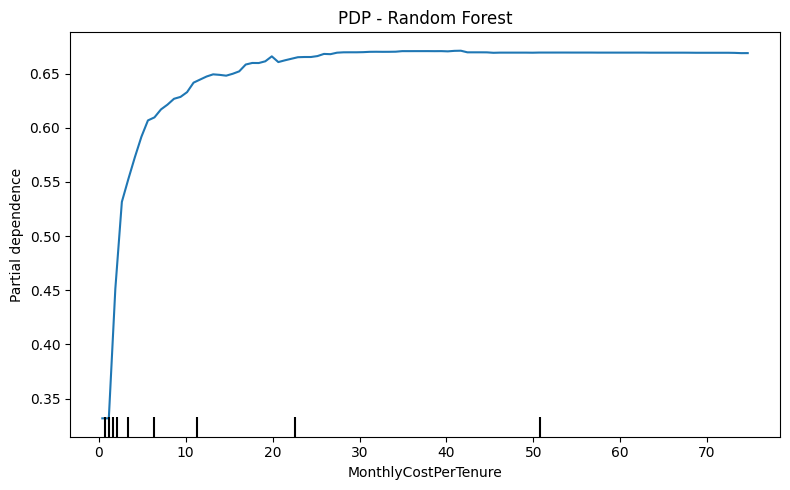

In [ ]:
print("\nPDP - Random Forest")
fig, ax = plt.subplots(figsize=(8, 5))
PartialDependenceDisplay.from_estimator(rf_final, X_test_final, [feature_index], ax=ax)
ax.set_title("PDP - Random Forest")
plt.tight_layout()
plt.show()

This PDP shows that as MonthlyCostPerTenure increases, the likelihood of churn also increases—especially sharply at low values.

The curve levels off after around 20, indicating that beyond this point, higher costs don’t significantly raise the churn risk further.

### ICE for Random Forest


ICE - Random Forest


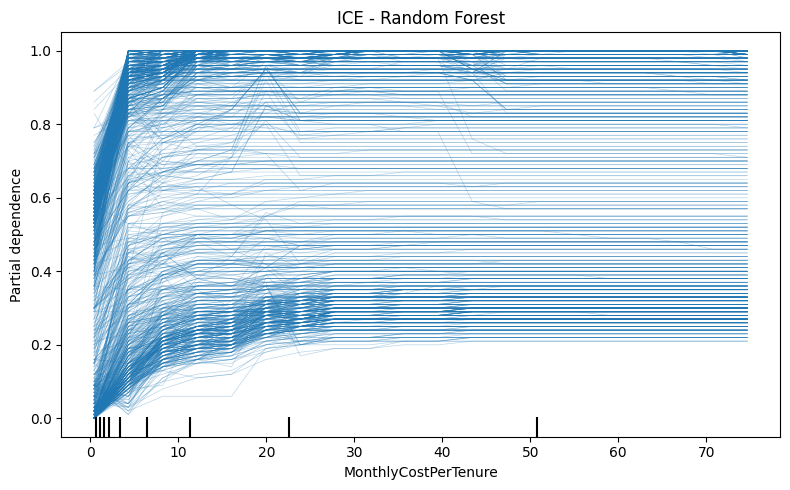

In [ ]:
print("\nICE - Random Forest")
fig, ax = plt.subplots(figsize=(8, 5))
PartialDependenceDisplay.from_estimator(rf_final, X_test_final, features=[feature_index], kind="individual", grid_resolution=20, ax=ax)
ax.set_title("ICE - Random Forest")
plt.tight_layout()
plt.show()

This ICE plot illustrates how the MonthlyCostPerTenure feature affects the churn prediction for individual customers.

Most lines trend upward, especially at low values, meaning as MonthlyCostPerTenure increases, predicted churn probability rises for many customers. The variation among lines shows individual sensitivity—some customers are more affected than others. This supports the PDP trend while revealing heterogeneity in individual responses.

## Decision Tree Model


Decision Tree Evaluation
Accuracy: 0.92
Precision: 0.92
Recall: 0.93
F1 Score: 0.92
AUC: 0.92
Classification Report:
               precision    recall  f1-score   support

           0       0.92      0.91      0.91       544
           1       0.92      0.93      0.92       635

    accuracy                           0.92      1179
   macro avg       0.92      0.92      0.92      1179
weighted avg       0.92      0.92      0.92      1179



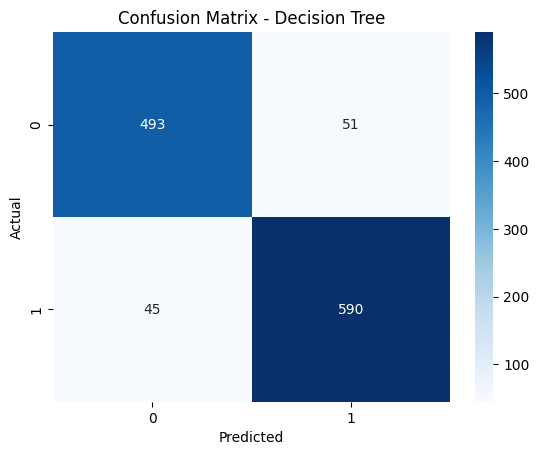

In [ ]:
dt_final = DecisionTreeClassifier(random_state=42)
dt_final.fit(X_train_final, y_train)
evaluate_model("Decision Tree", dt_final, X_test_final, y_test)

### SHAP for Decision Tree


SHAP Summary for Decision Tree


<Figure size 640x480 with 0 Axes>

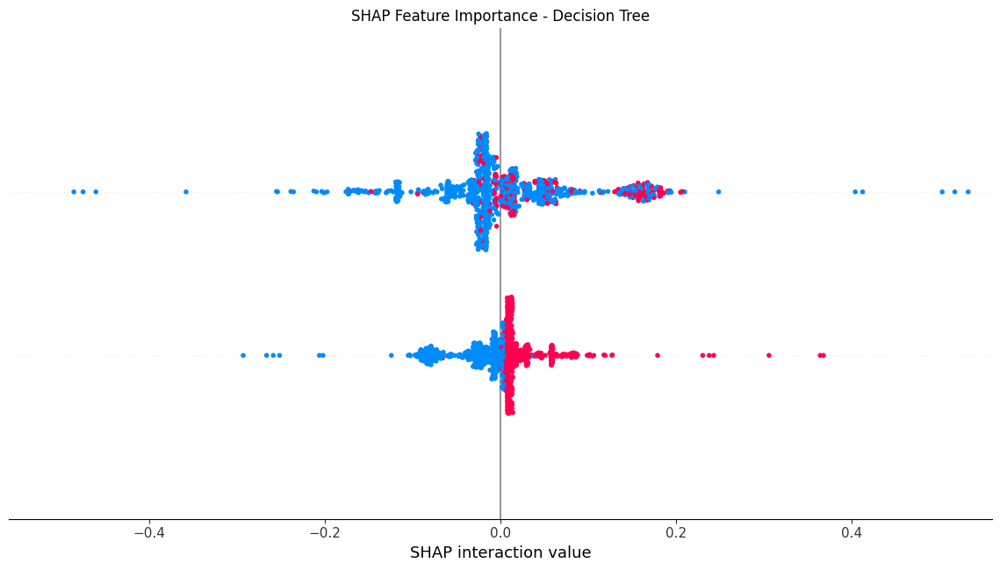

In [ ]:
print("\nSHAP Summary for Decision Tree")
explainer_dt = shap.TreeExplainer(dt_final)
shap_values_dt = explainer_dt.shap_values(X_test_final)
shap.summary_plot(shap_values_dt, X_test_final, plot_type="bar", show=False)
plt.title("SHAP Feature Importance - Decision Tree")
plt.tight_layout()
plt.show()

### LIME for Decision Tree

In [ ]:
print("\nLIME Explanation for Decision Tree")
exp = explainer.explain_instance(sample_instance.values, dt_final.predict_proba)
exp.show_in_notebook()


LIME Explanation for Decision Tree


This LIME explanation shows that the model predicts churn with 100% certainty for the selected customer. The most influential factors contributing to this decision are:

* High MonthlyCostPerTenure (43.80) and absence of Device Protection, both strongly pushing the prediction toward churn.

* Additional churn drivers include:
  * Low TotalCharges (≤ 247.16),
  * Lack of Tech Support and Online Security,
  * Negative discount score (paying more than average).

In contrast, features like DeviceProtection_Yes, OnlineSecurity_Yes, and PaperlessBilling_Yes slightly favor "No Churn," but their influence is minimal in this case.

### PDP for Decision Tree


PDP - Decision Tree


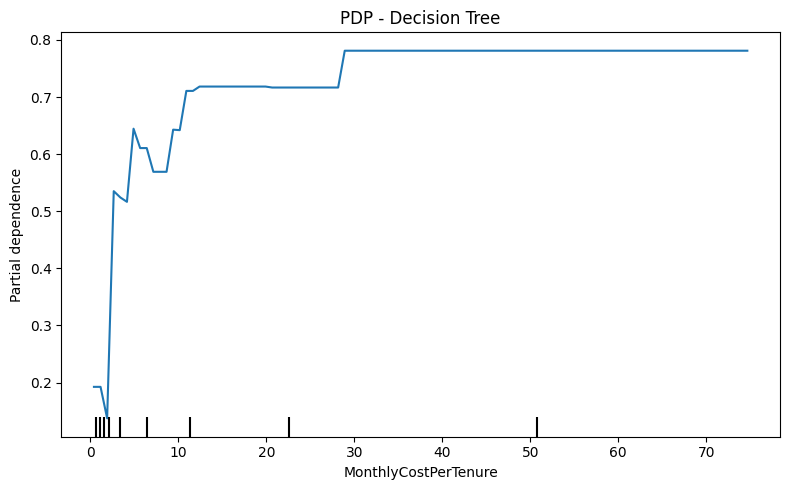

In [ ]:
print("\nPDP - Decision Tree")
fig, ax = plt.subplots(figsize=(8, 5))
PartialDependenceDisplay.from_estimator(dt_final, X_test_final, [feature_index], ax=ax)
ax.set_title("PDP - Decision Tree")
plt.tight_layout()
plt.show()

This Partial Dependence Plot illustrates how the feature MonthlyCostPerTenure affects the predicted probability of churn:

  * As MonthlyCostPerTenure increases from 0 to around 10, the churn probability rises sharply.

  * After a certain threshold (~10), the model predicts a consistently high churn probability (around 0.78).

  * The flat segments indicate the model's decision thresholds typical in tree-based models.

Customers who pay more relative to their tenure are significantly more likely to churn, and the model treats this relationship in discrete steps.

### ICE for Decision Tree


ICE - Decision Tree


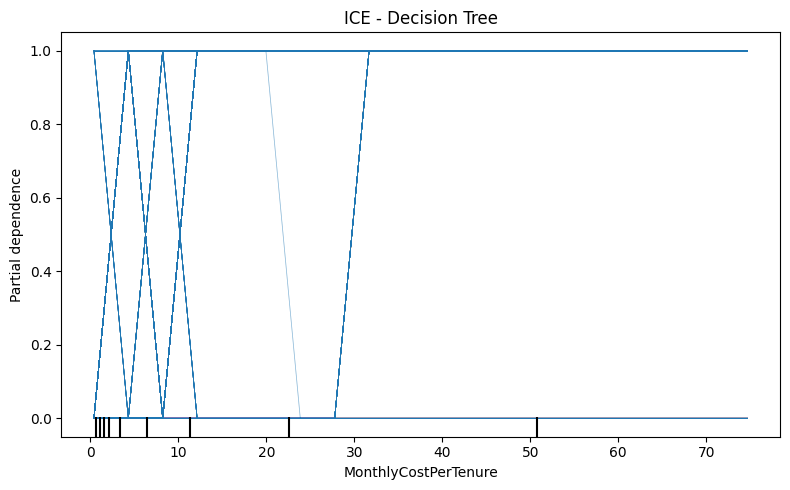

In [ ]:
print("\nICE - Decision Tree")
fig, ax = plt.subplots(figsize=(8, 5))
PartialDependenceDisplay.from_estimator(dt_final, X_test_final, features=[feature_index], kind="individual", grid_resolution=20, ax=ax)
ax.set_title("ICE - Decision Tree")
plt.tight_layout()
plt.show()

This ICE shows how predictions vary per individual as the feature MonthlyCostPerTenure changes:

  * The sharp vertical lines represent sudden changes in prediction, which is characteristic of decision trees due to their step-like splits.

  * Each line corresponds to a different customer; the model's prediction either jumps to a high or low value when crossing decision thresholds.

  * Many lines abruptly jump to 1.0 (high churn probability) at low MonthlyCostPerTenure, confirming that the model considers even small increases as strong churn indicators.

The Decision Tree model makes abrupt decisions based on MonthlyCostPerTenure, and for many users, a slight increase in cost leads to a strong shift in churn prediction.

## CatBoost Classifier Model


CatBoost Evaluation
Accuracy: 0.94
Precision: 0.93
Recall: 0.96
F1 Score: 0.95
AUC: 0.94
Classification Report:
               precision    recall  f1-score   support

           0       0.96      0.92      0.94       544
           1       0.93      0.96      0.95       635

    accuracy                           0.94      1179
   macro avg       0.95      0.94      0.94      1179
weighted avg       0.94      0.94      0.94      1179



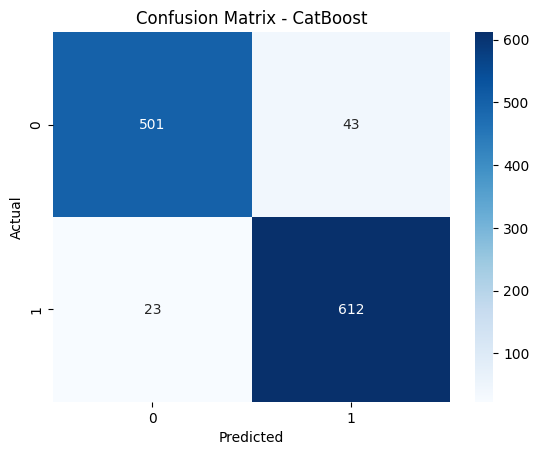

In [ ]:
cat_final = CatBoostClassifier(verbose=False, random_state=42)
cat_final.fit(X_train_final, y_train)
evaluate_model("CatBoost", cat_final, X_test_final, y_test)

### SHAP for CatBoost


SHAP Summary for CatBoost


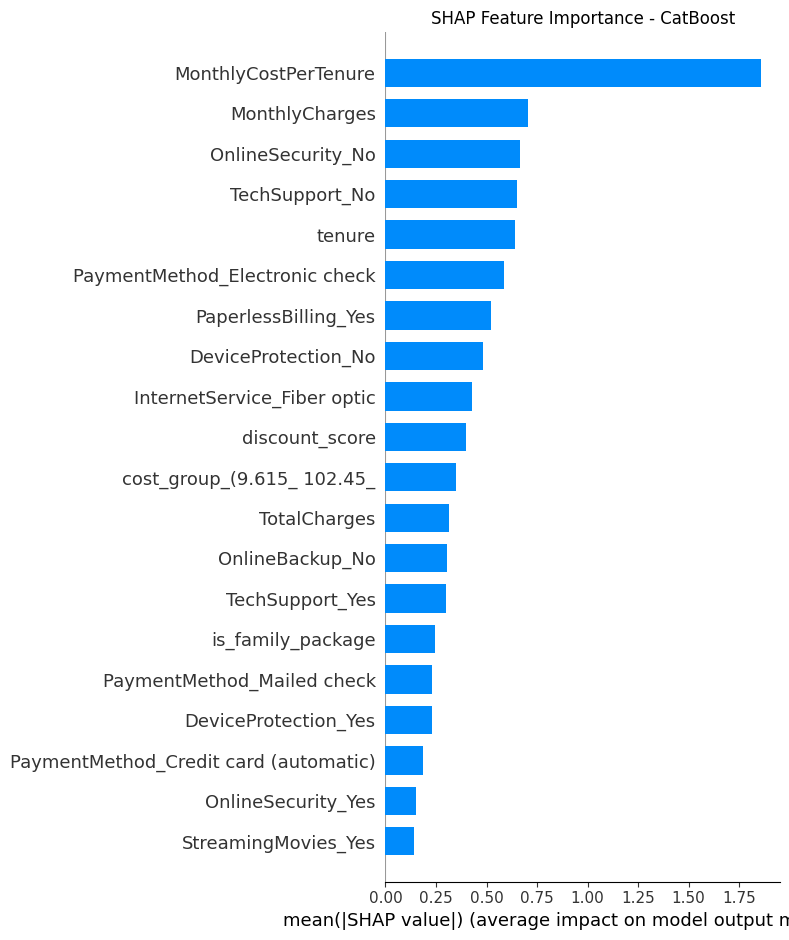

In [ ]:
print("\nSHAP Summary for CatBoost")
explainer_cat = shap.TreeExplainer(cat_final)
shap_values_cat = explainer_cat.shap_values(X_test_final)
shap.summary_plot(shap_values_cat, X_test_final, plot_type="bar", show=False)
plt.title("SHAP Feature Importance - CatBoost")
plt.tight_layout()
plt.show()

This SHAP bar plot shows the global feature importance in predicting customer churn:

* MonthlyCostPerTenure is by far the most influential feature, indicating that customers paying a high amount per tenure period are significantly more likely to churn.

* MonthlyCharges and OnlineSecurity_No follow, suggesting that high charges and lack of security services are strong churn drivers.

* Features like TechSupport_No, tenure, and PaymentMethod_Electronic check also contribute substantially—shorter tenure and electronic check payments are often associated with churn.

* Lower-ranked features, such as StreamingMovies_Yes and OnlineSecurity_Yes, have a weaker overall influence on model decisions.

The CatBoost model relies most heavily on billing-related features and service unavailability (like missing security or tech support) to predict churn.

### LIME for CatBoost

In [ ]:
print("\nLIME Explanation for CatBoost")
exp = explainer.explain_instance(sample_instance.values, cat_final.predict_proba)
exp.show_in_notebook()


LIME Explanation for CatBoost


This LIME explanation provides a local interpretation for a single customer prediction:

* The model predicts a 74% probability of churn.

* The most influential feature pushing the prediction toward churn is high MonthlyCostPerTenure (43.80), contributing 0.44 to the decision.

* Additional churn indicators include:

    * Lack of OnlineSecurity, TechSupport, and DeviceProtection

    * Use of Electronic check as a payment method

In contrast, features like TechSupport_Yes, PaperlessBilling_Yes, and use of credit card or mailed check for payment slightly counter the churn prediction.

For this specific customer, high payment relative to tenure, combined with the absence of support/security services and risky payment method, significantly raised the model’s confidence in predicting churn.

### PDP for CatBoost


PDP - CatBoost


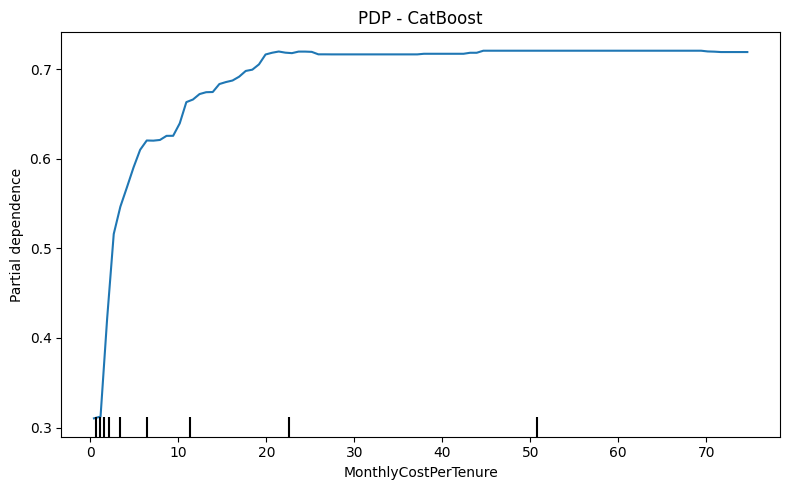

In [ ]:
print("\nPDP - CatBoost")
fig, ax = plt.subplots(figsize=(8, 5))
PartialDependenceDisplay.from_estimator(cat_final, X_test_final, [feature_index], ax=ax)
ax.set_title("PDP - CatBoost")
plt.tight_layout()
plt.show()

This Partial Dependence Plot shows how the feature MonthlyCostPerTenure affects the model’s prediction of churn:

  * The partial dependence rises steeply as MonthlyCostPerTenure increases, particularly in the 0 to 10 range.

  * Beyond a value of ~25, the curve plateaus, indicating that further increases in this feature do not significantly raise the predicted churn probability.

Customers who pay more per month relative to how long they've stayed are much more likely to churn. The risk stabilizes once the value reaches a high threshold, suggesting a saturation point in the model’s sensitivity to this feature.

### ICE for CatBoost

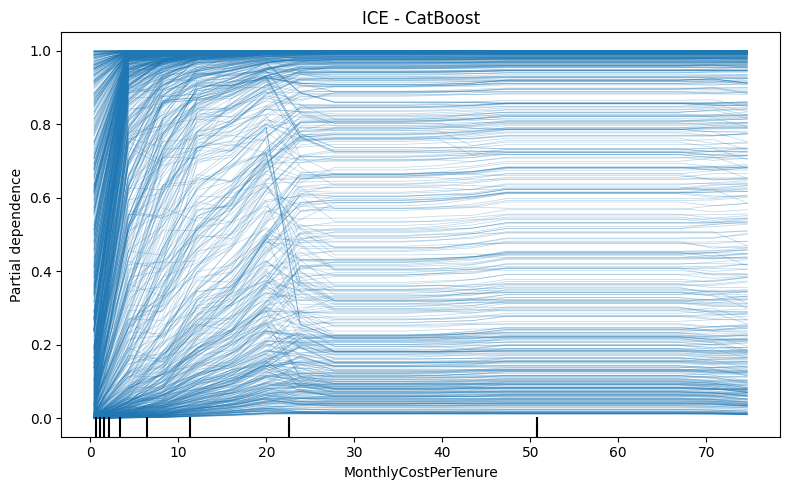

In [ ]:
fig, ax = plt.subplots(figsize=(8, 5))
PartialDependenceDisplay.from_estimator(cat_final, X_test_final, [feature_index], kind='individual', grid_resolution=20, ax=ax)
ax.set_title("ICE - CatBoost")
plt.tight_layout()
plt.show()

This ICE illustrates how the feature MonthlyCostPerTenure influences churn predictions at the individual customer level:

* Each line represents a single customer and how their predicted churn probability would change if only MonthlyCostPerTenure varied, while all other features remained fixed.

* The plot shows a consistent upward trend for many customers when MonthlyCostPerTenure increases from 0 to ~20, meaning their churn probability increases with cost.

* Beyond ~25, many lines flatten, indicating that higher values do not further affect the churn prediction for most customers.

* A few customers show non-linear or unexpected behavior, but the majority follow a similar increasing trend.

Higher MonthlyCostPerTenure strongly increases churn likelihood for many customers, especially in the low-to-mid range, reinforcing the PDP’s conclusion. ICE plots add value by revealing how individual responses differ even when the global trend is clear.

## XGBoost Classifier Model


XGBoost Evaluation
Accuracy: 0.94
Precision: 0.94
Recall: 0.96
F1 Score: 0.95
AUC: 0.94
Classification Report:
               precision    recall  f1-score   support

           0       0.95      0.92      0.94       544
           1       0.94      0.96      0.95       635

    accuracy                           0.94      1179
   macro avg       0.94      0.94      0.94      1179
weighted avg       0.94      0.94      0.94      1179



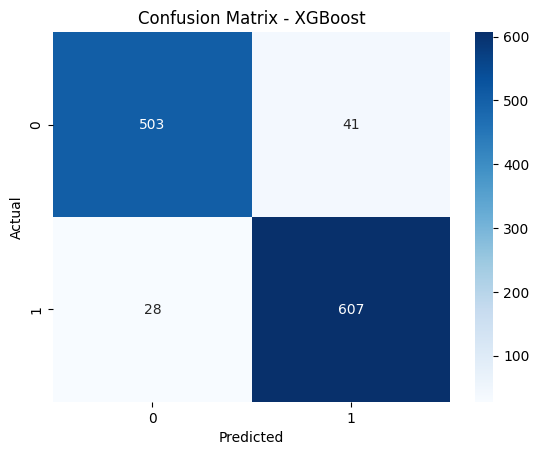

In [ ]:
xgb_final = XGBClassifier(use_label_encoder=False, eval_metric='logloss', random_state=42)
xgb_final.fit(X_train_final, y_train)
evaluate_model("XGBoost", xgb_final, X_test_final, y_test)

### SHAP for XGBoost


SHAP Summary for XGBoost


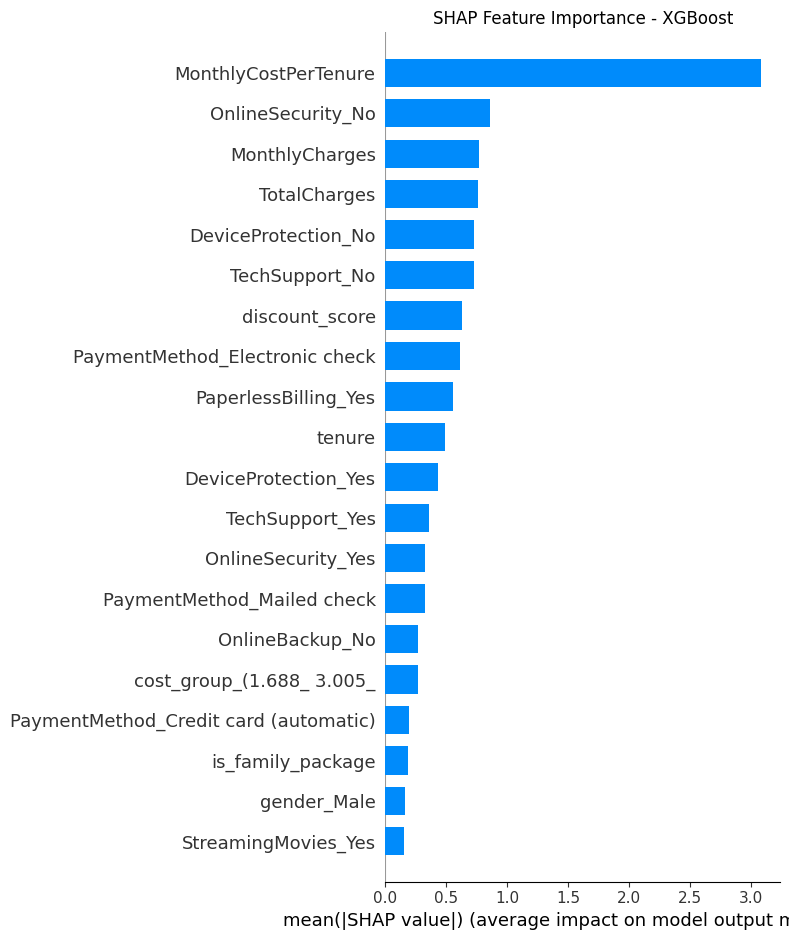

In [ ]:
print("\nSHAP Summary for XGBoost")
explainer_xgb = shap.TreeExplainer(xgb_final)
shap_values_xgb = explainer_xgb.shap_values(X_test_final)
shap.summary_plot(shap_values_xgb, X_test_final, plot_type="bar", show=False)
plt.title("SHAP Feature Importance - XGBoost")
plt.tight_layout()
plt.show()

This SHAP bar plot highlights the most impactful features driving churn predictions:

* MonthlyCostPerTenure stands out as the most influential feature, indicating that customers who pay more per unit of tenure are at a higher risk of churn.

* Other strong contributors include:

    * OnlineSecurity_No and TechSupport_No, signaling that lack of support services increases churn risk.

    * Billing features like MonthlyCharges, TotalCharges, and PaymentMethod_Electronic check also play notable roles.

    * discount_score also shows moderate influence, suggesting that price sensitivity is important.

    * Features like tenure have lower importance here compared to Logistic Regression, likely because MonthlyCostPerTenure already captures tenure indirectly.

The XGBoost model focuses heavily on cost-related features and absence of value-added services to predict churn. This aligns with patterns seen across other models but emphasizes the compounded effect of cost efficiency (e.g., value for money) on customer retention.

### LIME for XGBoost

In [ ]:
print("\nLIME Explanation for XGBoost")
exp = explainer.explain_instance(sample_instance.values, xgb_final.predict_proba)
exp.show_in_notebook()


LIME Explanation for XGBoost


This LIME explanation provides a local interpretation of a single churn prediction:

* The model predicts 84% probability of churn for this customer.

* The top positive contributors (increasing churn likelihood) include:

    * High MonthlyCostPerTenure (43.80) — strong impact (+0.41)

    * No Online Security and No Device Protection — both increase churn risk due to absence of protective services

    * No Tech Support and Electronic Check payment method — also contribute positively toward churn.

* On the other hand, features that reduce churn probability include:

  * Having TechSupport_Yes, PaperlessBilling_Yes, and Credit card (automatic) payment — often associated with satisfied or long-term customers.

This LIME output confirms the global SHAP insight: cost-effectiveness and service availability are key churn drivers. This customer pays a lot early (high MonthlyCostPerTenure) and lacks security/support services, which the model strongly associates with higher churn risk.


### PDP for XGBoost


PDP - XGBoost


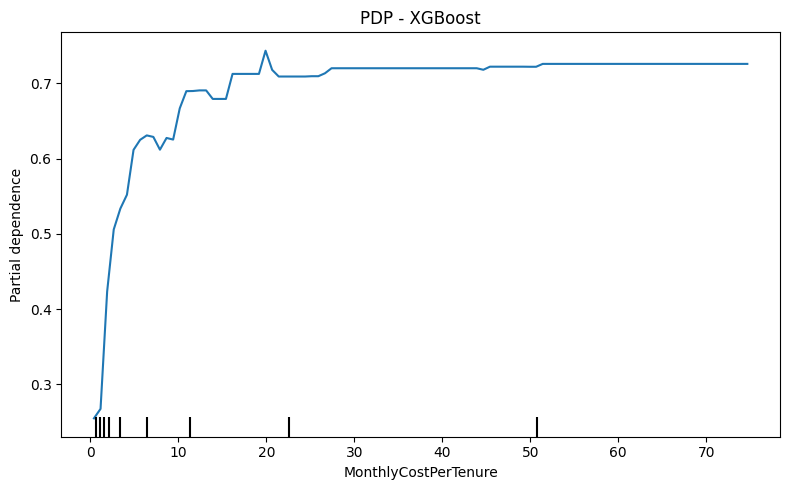

In [ ]:
print("\nPDP - XGBoost")
fig, ax = plt.subplots(figsize=(8, 5))
PartialDependenceDisplay.from_estimator(xgb_final, X_test_final, [feature_index], ax=ax)
ax.set_title("PDP - XGBoost")
plt.tight_layout()
plt.show()

This Partial Dependence Plot shows how the feature MonthlyCostPerTenure impacts churn predictions:

* The PDP indicates that as MonthlyCostPerTenure increases, the probability of churn increases sharply at first and then plateaus around a high value (~0.72).

* This suggests that customers who pay a high monthly charge relative to their tenure are much more likely to churn.

* After a certain threshold (~20 units), the model predicts consistently high churn risk, meaning that the risk stabilizes for extremely high values.

MonthlyCostPerTenure is a strong churn predictor in the XGBoost model. Customers paying disproportionately more than others early in their subscription are highly likely to churn.

### ICE for XGBoost

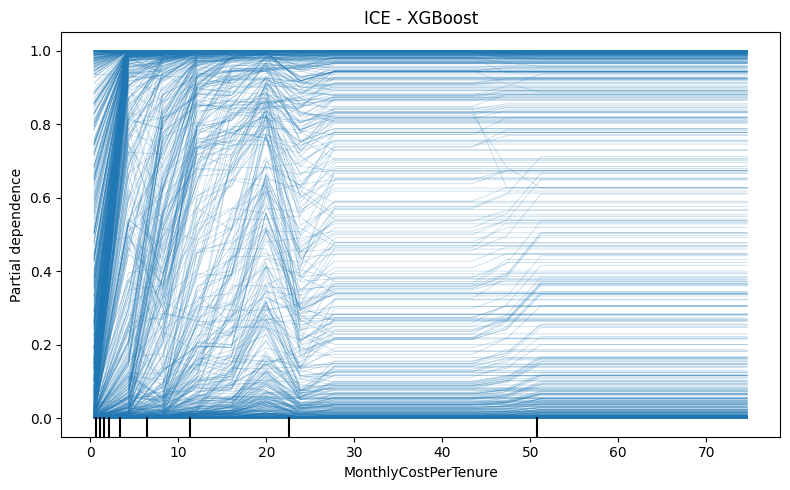

In [ ]:
fig, ax = plt.subplots(figsize=(8, 5))
PartialDependenceDisplay.from_estimator(xgb_final, X_test_final, [feature_index], kind='individual', grid_resolution=20, ax=ax)
ax.set_title("ICE - XGBoost")
plt.tight_layout()
plt.show()

This ICE plot shows the individual effects of the MonthlyCostPerTenure feature on predicted churn probability:

* Each blue line represents how churn probability changes for a specific customer as their MonthlyCostPerTenure varies.

* The majority of lines slope upward quickly and then flatten, indicating that higher costs relative to tenure sharply increase churn risk, especially in the lower ranges.

* After ~20 units, most lines reach high churn probability (close to 1.0), confirming a strong and consistent influence.

MonthlyCostPerTenure has a strong and consistent positive effect on churn predictions across most customers in the XGBoost model. This reinforces the feature’s critical role in model behavior and decision-making.

## LightGBM Classifier Model

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 2536, number of negative: 2176
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001476 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1131
[LightGBM] [Info] Number of data points in the train set: 4712, number of used features: 24
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.538200 -> initscore=0.153100
[LightGBM] [Info] Start training from score 0.153100

LightGBM Evaluation
Accuracy: 0.94
Precision: 0.94
Recall: 0.95
F1 Score: 0.94
AUC: 0.94
Classification Report:
               precision    recall  f1-score   support

           0       0.94      0.92      0.93       544
           1       0.94      0.95      0.94       635

    accuracy                           0.94      1179
   macro avg       0.94      0.94  

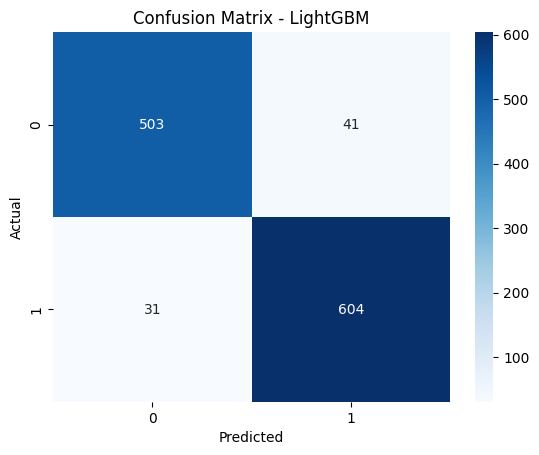

In [ ]:
lgb_final = LGBMClassifier(random_state=42)
lgb_final.fit(X_train_final, y_train)
evaluate_model("LightGBM", lgb_final, X_test_final, y_test)

### SHAP for LightGBM


SHAP Summary for LightGBM


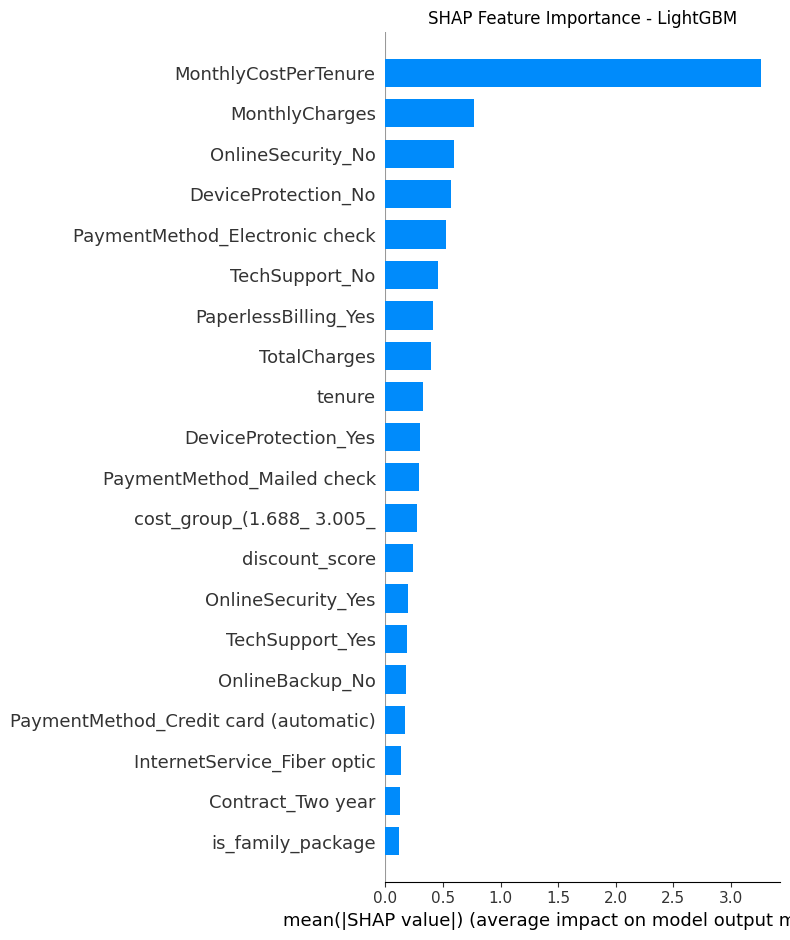

In [ ]:
print("\nSHAP Summary for LightGBM")
explainer_lgb = shap.TreeExplainer(lgb_final)
shap_values_lgb = explainer_lgb.shap_values(X_test_final)
shap.summary_plot(shap_values_lgb, X_test_final, plot_type="bar", show=False)
plt.title("SHAP Feature Importance - LightGBM")
plt.tight_layout()
plt.show()

This SHAP summary plot shows the average feature impact on churn predictions:

* MonthlyCostPerTenure is by far the most important feature, suggesting customers who pay more relative to their tenure are much more likely to churn.

* MonthlyCharges, OnlineSecurity_No, and DeviceProtection_No also have significant contributions, indicating billing and lack of security services increase churn risk.

* Other features like contract type, support availability, and payment method have smaller but noticeable impacts.

The LightGBM model heavily relies on billing behavior and service availability to predict churn, with MonthlyCostPerTenure being the most influential driver.

### LIME for LightGBM

In [ ]:
print("\nLIME Explanation for LightGBM")
exp = explainer.explain_instance(sample_instance.values, lgb_final.predict_proba)
exp.show_in_notebook()


LIME Explanation for LightGBM


This LIME explanation shows a local explanation for a single customer prediction:

* The model predicts a high probability of churn (84%).

* Key drivers toward churn include:

* High MonthlyCostPerTenure (contributes the most with +0.48),

* No Tech Support, Device Protection, or Online Security,

* Use of Electronic check as a payment method.

This customer pays a lot compared to how long they've been subscribed and lacks protection/support services, all of which increase churn risk. LIME confirms the global SHAP insights at an individual level.









### PDP for LightGBM


PDP - LightGBM


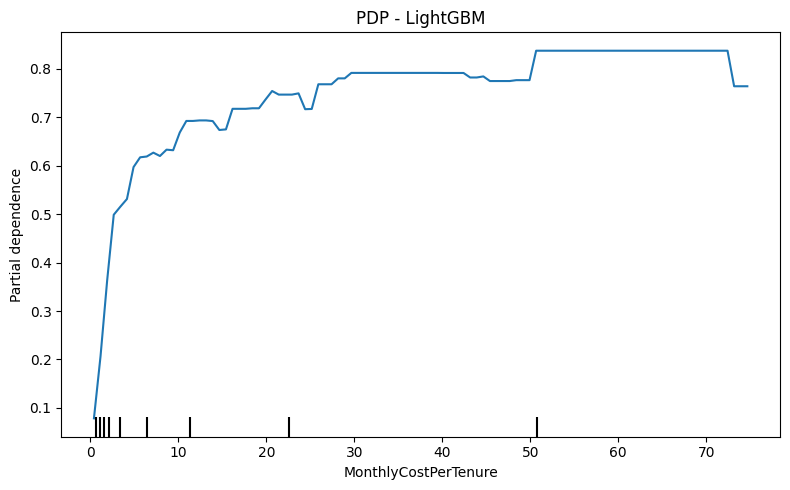

In [ ]:
print("\nPDP - LightGBM")
fig, ax = plt.subplots(figsize=(8, 5))
PartialDependenceDisplay.from_estimator(lgb_final, X_test_final, [feature_index], ax=ax)
ax.set_title("PDP - LightGBM")
plt.tight_layout()
plt.show()

This PDP shows the relationship between MonthlyCostPerTenure and churn probability:

* Positive Correlation: As MonthlyCostPerTenure increases, the partial dependence (the predicted churn risk) rises rapidly.

* Plateau Behavior: Around a cost per tenure of ~30, the curve flattens, suggesting that beyond this point, increasing cost has little additional effect on churn risk.

Customers who are paying more relative to their tenure are significantly more likely to churn. This supports the idea that high early costs may cause dissatisfaction and early exits.

### ICE for LightGBM

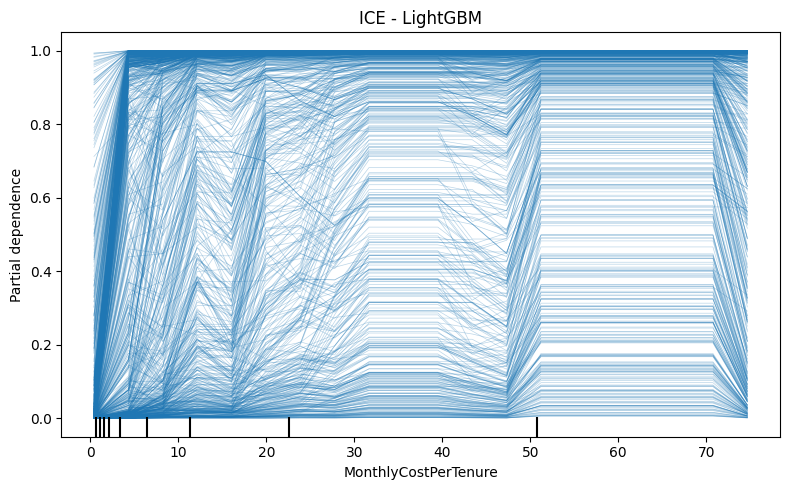

In [ ]:
fig, ax = plt.subplots(figsize=(8, 5))
PartialDependenceDisplay.from_estimator(lgb_final, X_test_final, [feature_index], kind='individual', grid_resolution=20, ax=ax)
ax.set_title("ICE - LightGBM")
plt.tight_layout()
plt.show()

This ICE plot illustrates how the MonthlyCostPerTenure feature affects predicted churn probability at the individual level:

* Sharp early increase: For most instances, churn probability jumps sharply when cost per tenure is low—showing sensitivity to this feature early on.

* Horizontal lines: After a certain threshold (~30–50), most lines flatten, indicating saturation—higher cost per tenure no longer increases predicted churn significantly.

* Individual variation: The spread of lines at lower values shows that different customers respond differently, confirming model nonlinearity and heterogeneity in churn behavior.

High early costs are critical churn triggers, while later increases have diminishing effects.

## KNN Model


KNN Evaluation
Accuracy: 0.90
Precision: 0.89
Recall: 0.93
F1 Score: 0.91
AUC: 0.90
Classification Report:
               precision    recall  f1-score   support

           0       0.92      0.87      0.89       544
           1       0.89      0.93      0.91       635

    accuracy                           0.90      1179
   macro avg       0.91      0.90      0.90      1179
weighted avg       0.90      0.90      0.90      1179



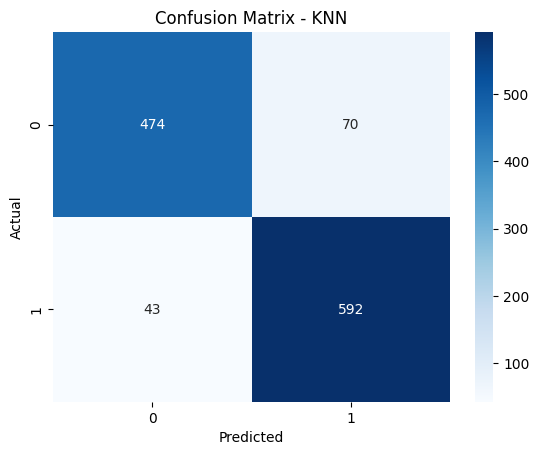

In [ ]:
knn_final = KNeighborsClassifier(n_neighbors=15)
knn_final.fit(X_train_final, y_train)
evaluate_model("KNN", knn_final, X_test_final, y_test)

### LIME for KNN

In [ ]:
print("\nLIME Explanation for KNN")
exp = explainer.explain_instance(sample_instance.values, knn_final.predict_proba)
exp.show_in_notebook()


LIME Explanation for KNN


This LIME explanation gives a local interpretation of one churn prediction:

* Churn Probability: The model predicts an 80% chance of churn.

* Top contributors to churn:

    * TotalCharges ≤ 247.16: Low total charges indicate the customer is relatively new.

    * tenure ≤ 4: Very short tenure strengthens the churn signal.

    * Negative discount_score: Suggests the customer isn’t receiving a competitive price.

    * High MonthlyCostPerTenure: Paying a lot early in the relationship contributes to churn.

* Features against churn:

    * Features like using a credit card for payment, being male, and being in a family package appear to slightly reduce churn, but with minimal impact here.

This customer is flagged as high-risk due to low tenure, low total charges, and unfavorable pricing—classic early-stage churn indicators.

### PDP for KNN


PDP - KNN


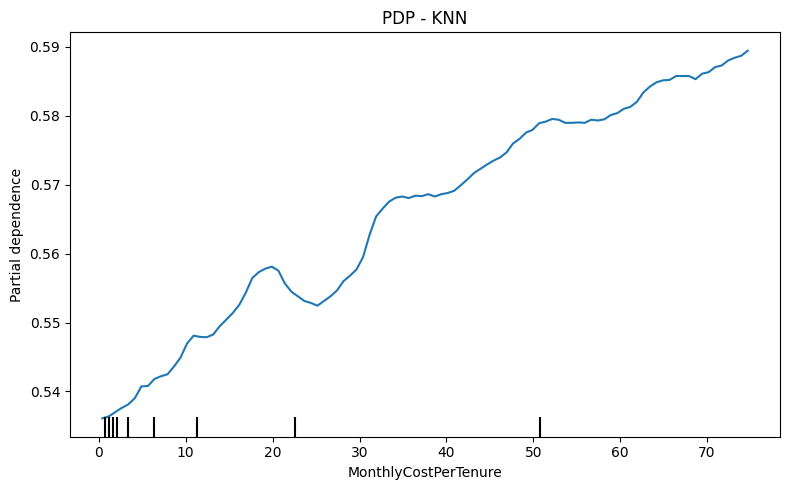

In [ ]:
print("\nPDP - KNN")
fig, ax = plt.subplots(figsize=(8, 5))
PartialDependenceDisplay.from_estimator(knn_final, X_test_final, [feature_index], ax=ax)
ax.set_title("PDP - KNN")
plt.tight_layout()
plt.show()

This PDP shows the relationship between MonthlyCostPerTenure and the predicted churn probability across all customers.

Overall Trend: As MonthlyCostPerTenure increases, churn probability gradually rises.

Interpretation: Customers who pay more per unit of tenure are more likely to churn.

Model Behavior: The plot is relatively smooth, though KNN typically shows more fluctuation—indicating moderate sensitivity to this feature.

This confirms that KNN associates higher cost per tenure with increased churn risk, although the effect is more gradual compared to tree-based models.

### ICE for KNN

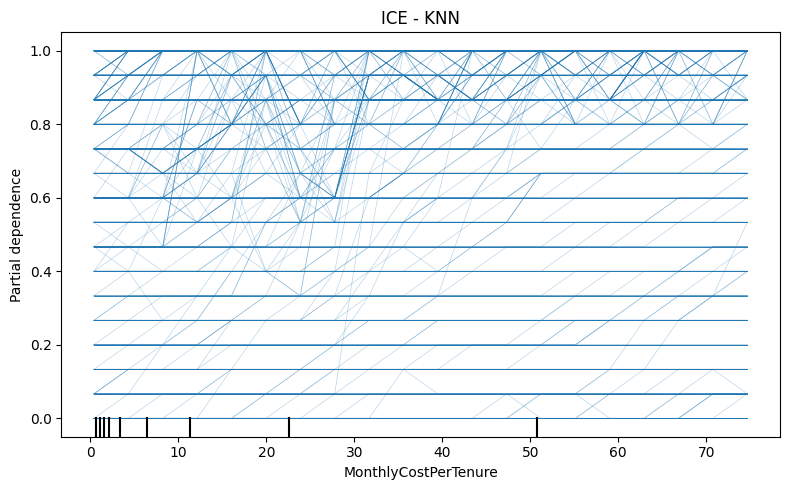

In [ ]:
fig, ax = plt.subplots(figsize=(8, 5))
PartialDependenceDisplay.from_estimator(knn_final, X_test_final, [feature_index], kind='individual', grid_resolution=20, ax=ax)
ax.set_title("ICE - KNN")
plt.tight_layout()
plt.show()

This ICE plot for the KNN model shows how MonthlyCostPerTenure affects churn prediction for individual customers.

Flat Lines: Most lines are flat or have sudden jumps, indicating that predictions change abruptly for some customers, but remain constant for others.

Discontinuous Behavior: This pattern is expected in KNN, which makes decisions based on discrete neighbor sets rather than smooth trends.

High Churn Zones: Many customers have predictions close to 1.0 (high churn), regardless of MonthlyCostPerTenure, especially at higher values.

The ICE plot shows that KNN’s churn predictions can be abrupt and vary sharply per customer, with limited smooth responsiveness to changes in MonthlyCostPerTenure.

## Neural Network Model


Neural Network Evaluation
Accuracy: 0.88
Precision: 0.91
Recall: 0.86
F1 Score: 0.88
AUC: 0.88
Classification Report:
               precision    recall  f1-score   support

           0       0.85      0.90      0.87       544
           1       0.91      0.86      0.88       635

    accuracy                           0.88      1179
   macro avg       0.88      0.88      0.88      1179
weighted avg       0.88      0.88      0.88      1179



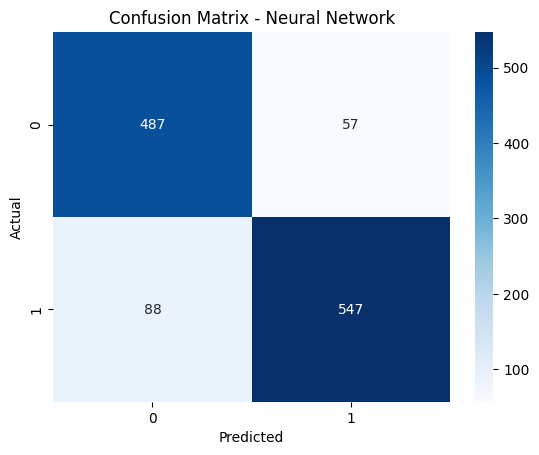

In [ ]:
nn_final = MLPClassifier(hidden_layer_sizes=(128, 64), activation='relu', max_iter=500, random_state=42)
nn_final.fit(X_train_final, y_train)
evaluate_model("Neural Network", nn_final, X_test_final, y_test)

### LIME for NN

In [ ]:
print("\nLIME Explanation for Neural Network (MLP)")
exp = explainer.explain_instance(sample_instance.values, nn_final.predict_proba)
exp.show_in_notebook()


LIME Explanation for Neural Network (MLP)


Predicted churn probability = 93%.

The model strongly believes the customer will churn.

Key contributors toward churn:

* Low TotalCharges (≤ 247.16) → strongest indicator of churn (0.34).

* Low discount_score → they’re not receiving a price benefit.

* High MonthlyCostPerTenure → paying more in a shorter time.

* Paperless billing + short contract patterns (implied by other features).

Key contributors against churn:
* Features like OnlineSecurity_Yes = 0, OnlineBackup_No = 1, and StreamingMovies_Yes = 0 help reduce churn risk slightly — but not enough to outweigh the stronger churn signals.

This customer is flagged as high risk of churn due to paying high costs early (MonthlyCostPerTenure, TotalCharges), not receiving discounts, and lacking certain support features.

### PDP for NN


PDP - MLP


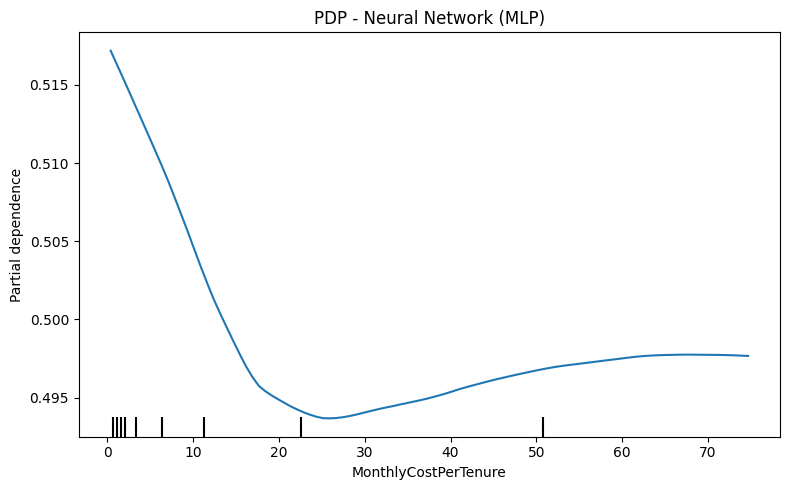

In [ ]:
print("\nPDP - MLP")
fig, ax = plt.subplots(figsize=(8, 5))
PartialDependenceDisplay.from_estimator(nn_final, X_test_final, [feature_index], ax=ax)
ax.set_title("PDP - Neural Network (MLP)")
plt.tight_layout()
plt.show()

This PDP for the Neural Network (MLP) model shows how MonthlyCostPerTenure affects the average predicted churn probability.

Negative Relationship (0–25): As MonthlyCostPerTenure increases from low values up to ~25, churn probability decreases. This suggests that customers paying moderately more relative to their tenure might be more committed.

Flattening Trend (>25): After ~25, the curve levels off and slightly increases, indicating that higher values of MonthlyCostPerTenure have minimal additional effect or may slightly raise churn risk.

The MLP model learns a nonlinear relationship where churn risk drops initially with increased cost-per-tenure, but the effect plateaus later. This reflects a stabilization in the model’s perception of churn likelihood at higher cost levels.








### ICE for NN

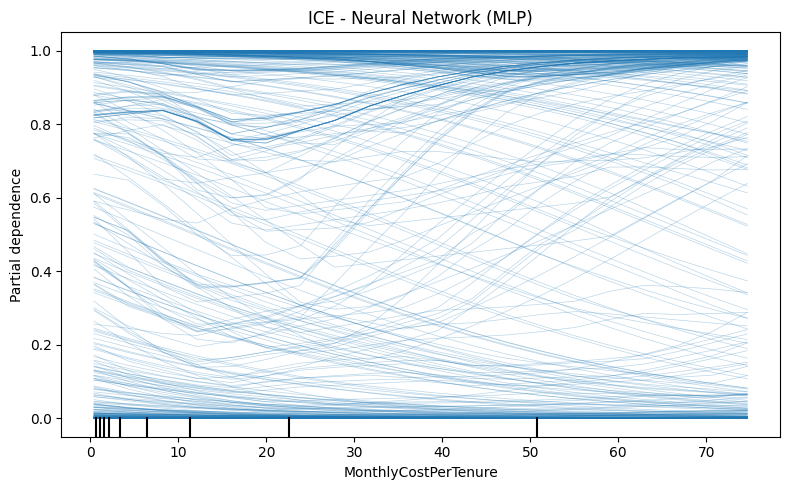

In [ ]:
fig, ax = plt.subplots(figsize=(8, 5))
PartialDependenceDisplay.from_estimator(nn_final, X_test_final, [feature_index], kind='individual', grid_resolution=20, ax=ax)
ax.set_title("ICE - Neural Network (MLP)")
plt.tight_layout()
plt.show()

This ICE plot shows how MonthlyCostPerTenure influences churn predictions for individual customers.

Many lines start high and decrease: For several customers, increasing MonthlyCostPerTenure reduces churn probability — possibly indicating that early high-cost users are seen as more committed.

Some lines remain flat: These customers' churn predictions are insensitive to changes in this feature — suggesting other features dominate for them.

Others slightly increase: A few lines trend upward, implying higher cost-per-tenure increases churn risk for those customers.

The ICE plot reveals customer-specific variability in how MonthlyCostPerTenure affects churn. The MLP model shows a nonlinear and heterogeneous response, aligning with the smoother global trend seen in the PDP.

## Comparsion Of Models

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 2536, number of negative: 2176
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001083 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1131
[LightGBM] [Info] Number of data points in the train set: 4712, number of used features: 24
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.538200 -> initscore=0.153100
[LightGBM] [Info] Start training from score 0.153100


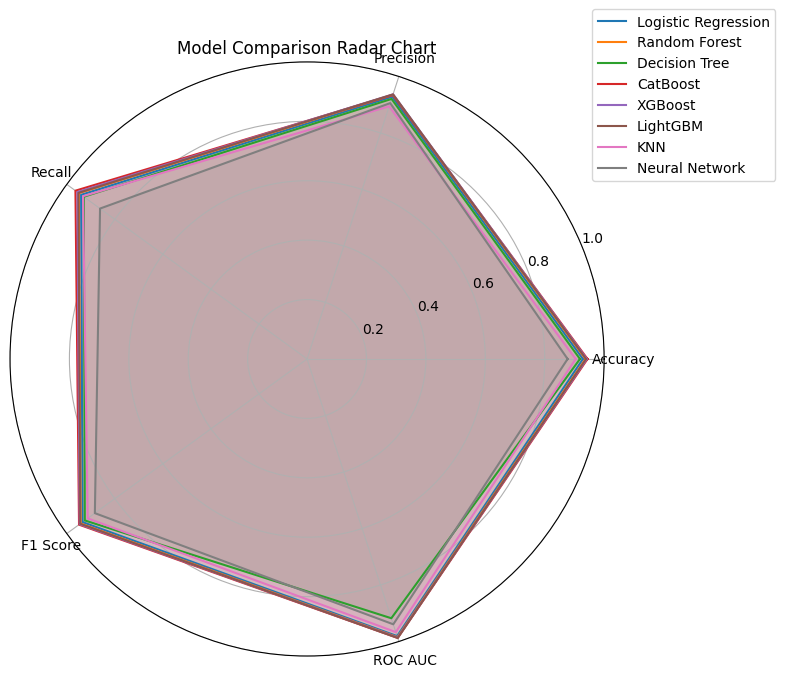

In [ ]:
models = {
    'Logistic Regression': log_final,
    'Random Forest': rf_final,
    'Decision Tree': dt_final,
    'CatBoost': cat_final,
    'XGBoost': xgb_final,
    'LightGBM': lgb_final,
    'KNN': knn_final,
    'Neural Network': nn_final
}
labels = ['Accuracy', 'Precision', 'Recall', 'F1 Score', 'ROC AUC']
metrics = {}

for name, model in models.items():
    model.fit(X_train_final, y_train)
    preds = model.predict(X_test_final)
    try:
        probs = model.predict_proba(X_test_final)[:, 1]
    except:
        probs = preds

    scores = [
        accuracy_score(y_test, preds),
        precision_score(y_test, preds),
        recall_score(y_test, preds),
        f1_score(y_test, preds),
        roc_auc_score(y_test, probs)
    ]
    metrics[name] = scores

# Radar Chart Comparison
import numpy as np
fig, ax = plt.subplots(figsize=(8, 8), subplot_kw=dict(polar=True))
angles = np.linspace(0, 2 * np.pi, len(labels), endpoint=False).tolist()
angles += angles[:1]

for model_name, score_list in metrics.items():
    values = score_list + [score_list[0]]
    ax.plot(angles, values, label=model_name)
    ax.fill(angles, values, alpha=0.1)

ax.set_thetagrids(np.degrees(angles[:-1]), labels)
ax.set_ylim(0, 1)
ax.set_title('Model Comparison Radar Chart')
ax.legend(loc='upper right', bbox_to_anchor=(1.3, 1.1))
plt.tight_layout()
plt.show()

XGBoost, CatBoost, and LightGBM consistently lead across all metrics. Their performance lines form the outermost edges on the radar plot.

Neural Network (MLP) performs closely to the ensemble models but shows slightly lower Recall and F1 Score, suggesting it may miss more churn cases.

Logistic Regression and Decision Tree are slightly weaker, especially in Recall and ROC AUC, indicating they may not capture minority (churn) class as effectively.

KNN underperforms across most metrics, particularly in Recall and ROC AUC, which suggests it struggles with class boundaries in this dataset.

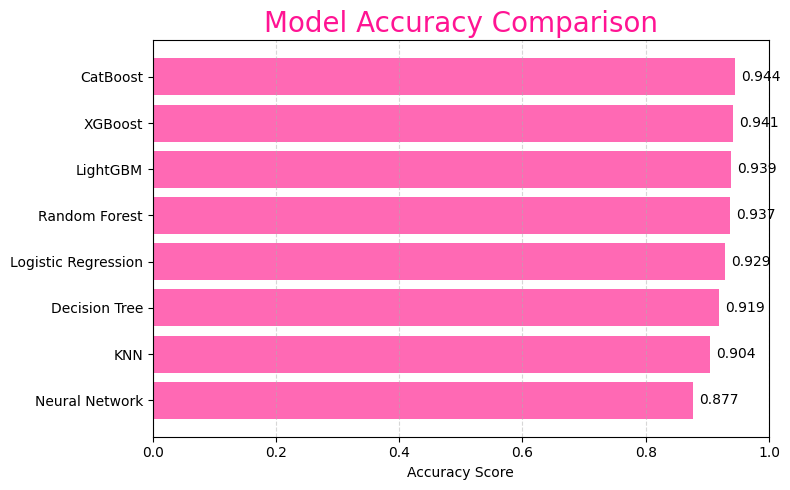

In [ ]:
accuracy_scores = {model: scores[0] for model, scores in metrics.items()}
accuracy_scores = dict(sorted(accuracy_scores.items(), key=lambda item: item[1], reverse=True))
fig, ax = plt.subplots(figsize=(8, 5))
bars = ax.barh(list(accuracy_scores.keys()), list(accuracy_scores.values()), color='hotpink')
for bar in bars:
    width = bar.get_width()
    ax.text(width + 0.01, bar.get_y() + bar.get_height()/2,
            f"{width:.3f}", va='center', ha='left', fontsize=10)
ax.set_title("Model Accuracy Comparison", fontsize=20, color='deeppink')
ax.set_xlabel("Accuracy Score")
ax.set_xlim(0, 1)
plt.gca().invert_yaxis()
plt.grid(axis='x', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()